In [1]:
%run ~/.python/init.ipynb

In [2]:
import torch
from torchvision import transforms
import torchvision
import torch.nn as nn
import torch.optim as optim
from torch.optim import lr_scheduler
import time
import copy
import PIL

In [3]:
root = Path('/ubc/cs/research/plai-scratch/video-diffusion-shared/datasets/carla-no-traffic-regression_small')
train_path = root / 'train'
test_path = root / 'test'

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [4]:
def read_gif(filename):
    """ readGif(filename, asNumpy=True)
    
    Read images from an animated GIF file.  Returns a list of numpy 
    arrays, or, if asNumpy is false, a list if PIL images.
    
    """
    # Load file using PIL
    pilIm = PIL.Image.open(filename)    
    pilIm.seek(0)
    
    # Read all images inside
    images = []
    try:
        while True:
            # Get image as numpy array
            tmp = pilIm.convert() # Make without palette
            a = np.asarray(tmp)
            if len(a.shape)==0:
                raise MemoryError("Too little memory to convert PIL image to array")
            # Store, and next
            images.append(a)
            pilIm.seek(pilIm.tell()+1)
    except EOFError:
        pass
    
    # Done
    return images 

In [5]:
# ## manually prune bad videos 
# del dataloaders["video-2_2_6c4f1bf95c42565d03ea.gif"]
# del dataloaders["video-3_2_71b981b2a93813bcd537.gif"]
# del dataloaders["video-0_2_b3ac7c76bd4ca23e3039.gif"]
# del dataloaders["video-1_2_649ea4b227304719448b.gif"]
# ! rm  ./sampled_videos/video-2_2_6c4f1bf95c42565d03ea.gif ./sampled_videos/video-3_2_71b981b2a93813bcd537.gif ./sampled_videos/video-0_2_b3ac7c76bd4ca23e3039.gif ./sampled_videos/video-1_2_649ea4b227304719448b.gif

In [6]:
class GIFDataset(torch.utils.data.Dataset):
    def __init__(self, path, transforms=None):
        self.path = path
        self.transforms = transforms
        # load all images in gif
        self.imgs = read_gif(path)

    def __getitem__(self, idx):
        # load images and masks         
        img = self.imgs[idx].copy()
            
        if self.transforms is not None:
            img = self.transforms(img)
        return img

    def __len__(self):
        return len(self.imgs)

In [ ]:
class CARLADataset(torch.utils.data.Dataset):
    def __init__(self, root, transforms=None):
        self.root = root
        self.transforms = transforms
        # load all image files, sorting them to ensure that they are aligned
        self.imgs = sorted([p.parts[-1] for p in self.root.glob("video*.npy")])
        self.labels = sorted([p.parts[-1] for p in self.root.glob("coords*.npy")])

    def __getitem__(self, idx):
        # load images and masks         
        img = np.load(self.root / self.imgs[idx])
        target = np.load(self.root / self.labels[idx])

        # use x,y only
        target = target[[0,1]]
            
        if self.transforms is not None:
            img = self.transforms(img)

        return img, target

    def __len__(self):
        return len(self.imgs)
    

In [116]:
def imshow(inp, title=None):
    """Imshow for Tensor."""
    inp = inp.numpy().transpose((1, 2, 0))
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)

    fig, ax = plt.subplots(figsize=(12,24))
    ax.imshow(inp, interpolation='nearest')
    plt.tight_layout()
    if title is not None:
        plt.title(title)
    plt.pause(0.001)  # pause a bit so that plots are updated
    

In [117]:
def load_model(path):
    model = torchvision.models.resnet18(pretrained=True)
    num_ftrs = model.fc.in_features
    model.fc = nn.Linear(num_ftrs, 2) # added dimension for classification

    model = model.to(device)
    model.load_state_dict(torch.load(path))
    model.eval()
    return model

In [138]:
def predict_trajectory(dataloader):
    inputs = next(iter(dataloader))
    inputs = inputs.to(device)
    outputs = model(inputs)
    return outputs.cpu().detach().numpy()
    

In [118]:
data_transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])])

dataloaders = {
    path.parts[-1]: torch.utils.data.DataLoader(
        GIFDataset(path, data_transform),
        batch_size=20, # all gifs are length 20
        shuffle=False,
        num_workers=2) 
    for path in Path("./sampled_videos/").glob("*.gif")
}

dataset_sizes = {x: len(dataloaders[x].dataset) for x in dataloaders.keys()}

In [186]:
model = load_model('./models/model.pth')

In [187]:
gifs = list(dataloaders.keys())

In [183]:
def plot_trajectory(out, k):
    fig, ax = plt.subplots(1, 1, dpi=150, figsize=(4, 3))

    x, y = out[:, 0], out[:,1]
    
    ax = sns.lineplot(x=x,
                      y=y,
                      sort=False,
                      lw=1,
                      ax=ax,
                      label=k,
                      legend=False,
                     )

    xlim = (-10, 400)
    ylim = (-10, 350)
    ax.set_xlim(*xlim)
    ax.set_ylim(*ylim)
    handles, labels = ax.get_legend_handles_labels()
    fig.legend(handles,
               labels,
               ncol=5,
               loc='lower center',
               bbox_to_anchor=(0.5, -0.1),
               bbox_transform=plt.gcf().transFigure
              )
    plt.show()

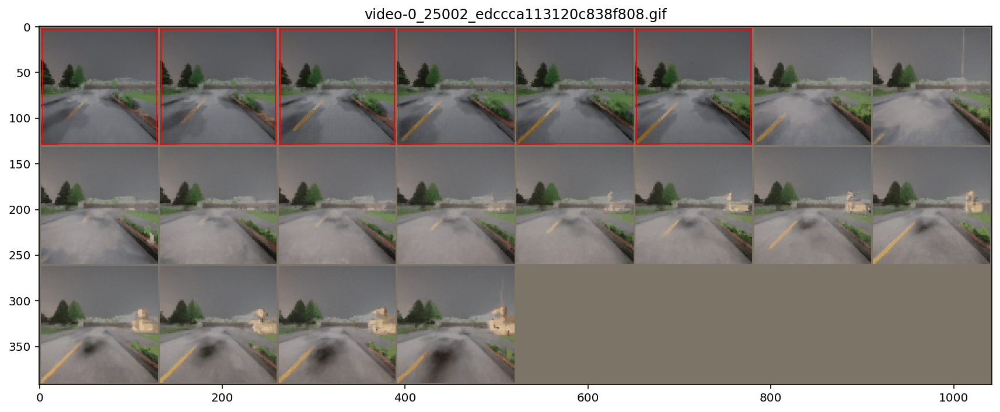

[[ 9.766617   22.565292  ]
 [ 9.7499695  21.537933  ]
 [ 7.4454193  22.221764  ]
 [ 9.413345   20.33657   ]
 [ 9.416138   20.26648   ]
 [ 8.046341   19.477394  ]
 [ 0.12097168 21.730362  ]
 [ 4.933792   22.031685  ]
 [ 5.6755066  23.445786  ]
 [ 6.963043   26.025345  ]
 [ 2.5438843  25.00795   ]
 [ 3.043579   26.706627  ]
 [ 8.177765   29.237144  ]
 [ 3.229477   26.631287  ]
 [ 2.1768494  25.310455  ]
 [ 3.2949371  28.455704  ]
 [ 8.615906   29.744034  ]
 [54.172264   40.206398  ]
 [60.251778   56.587112  ]
 [59.337067   63.93132   ]]


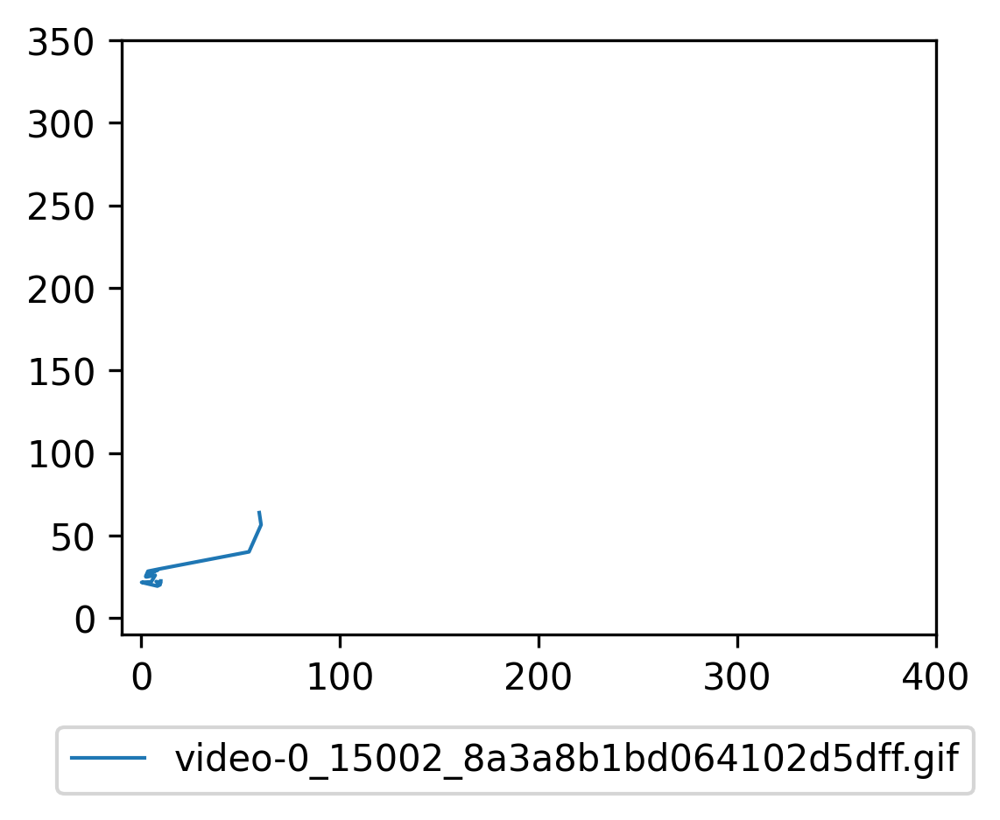

-------------------------------


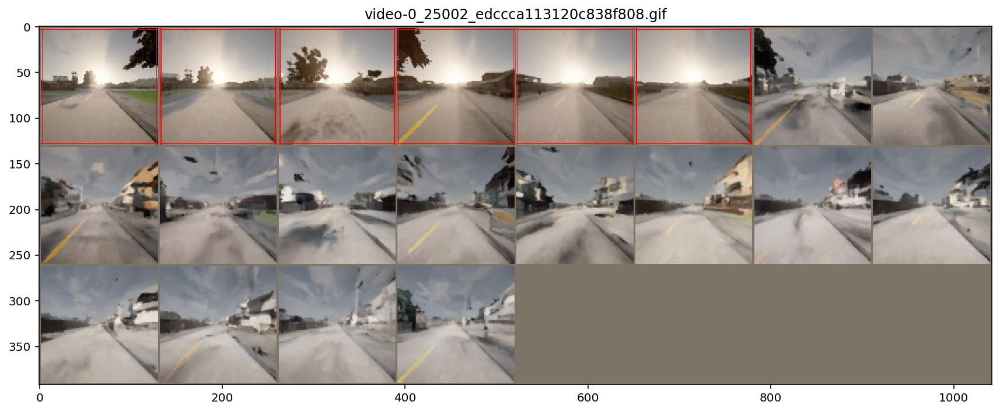

[[180.81491   54.191612]
 [165.87138   61.322533]
 [159.9516    55.437805]
 [141.41516   53.021202]
 [132.10844   54.012894]
 [115.90495   53.233994]
 [ 99.58194  221.09557 ]
 [ 85.14823   26.452438]
 [ 94.62865  256.48907 ]
 [122.13957   71.25008 ]
 [ 96.39903  214.10747 ]
 [ 80.891556 292.44427 ]
 [ 90.9342   231.18088 ]
 [183.07056   20.232132]
 [117.59625  118.62196 ]
 [ 91.17728  257.99268 ]
 [114.67974  115.14133 ]
 [104.30298  132.76859 ]
 [114.583496 183.97495 ]
 [ 89.07461  244.33267 ]]


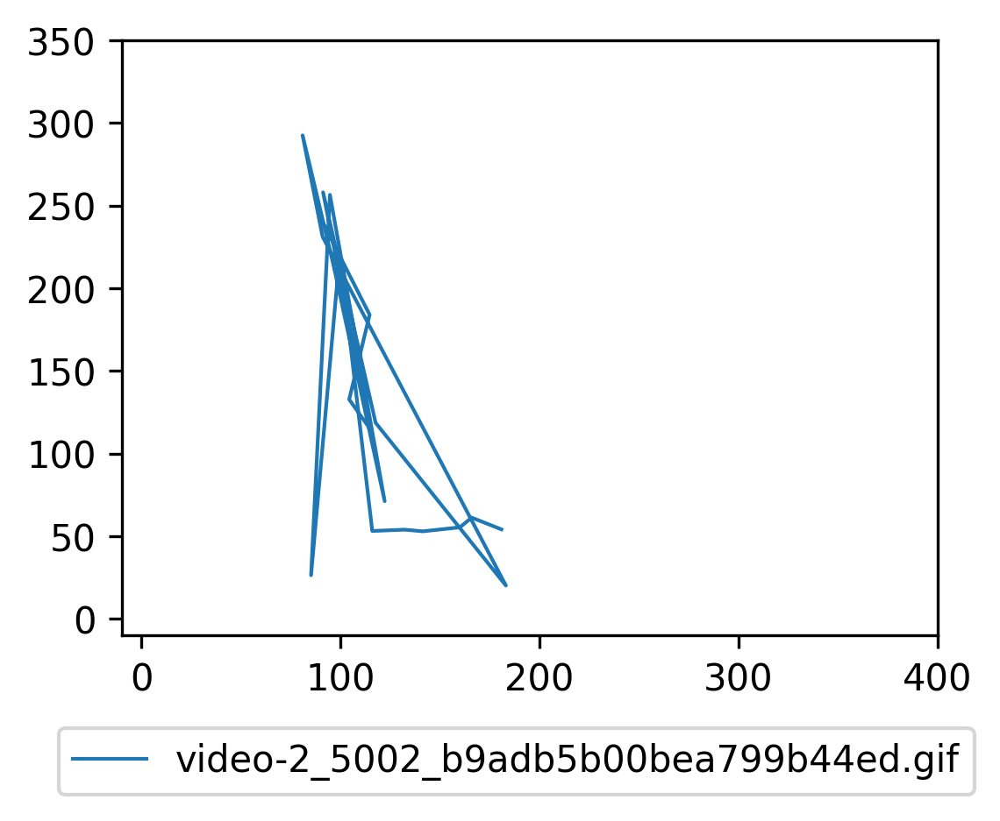

-------------------------------


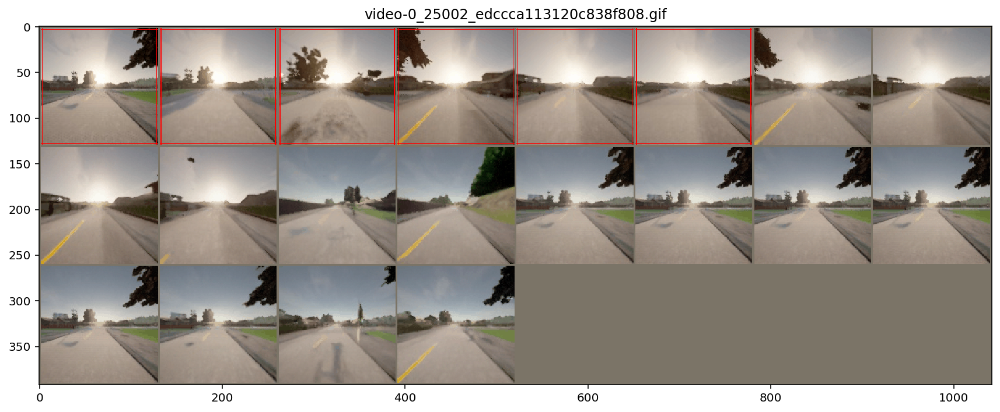

[[180.81491   54.191612]
 [165.87138   61.322533]
 [159.9516    55.437805]
 [141.41516   53.021202]
 [132.10844   54.012894]
 [115.90495   53.233994]
 [154.11436   46.90985 ]
 [135.4369    51.467133]
 [133.45627   53.105255]
 [126.78232   50.24299 ]
 [201.8718    19.387428]
 [332.4172     8.446182]
 [174.48398   52.31607 ]
 [178.33788   53.605118]
 [177.93808   53.529007]
 [178.6055    53.82585 ]
 [177.7122    53.424393]
 [175.69896   53.213287]
 [107.350006  88.78124 ]
 [154.72215   55.68245 ]]


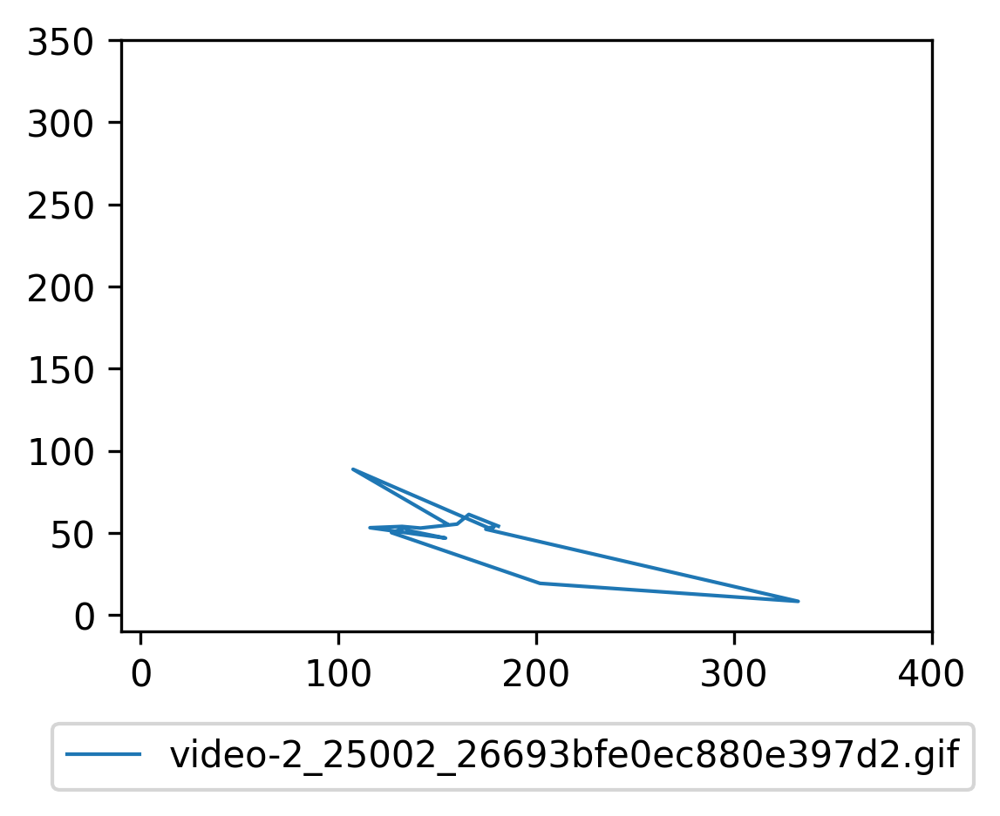

-------------------------------


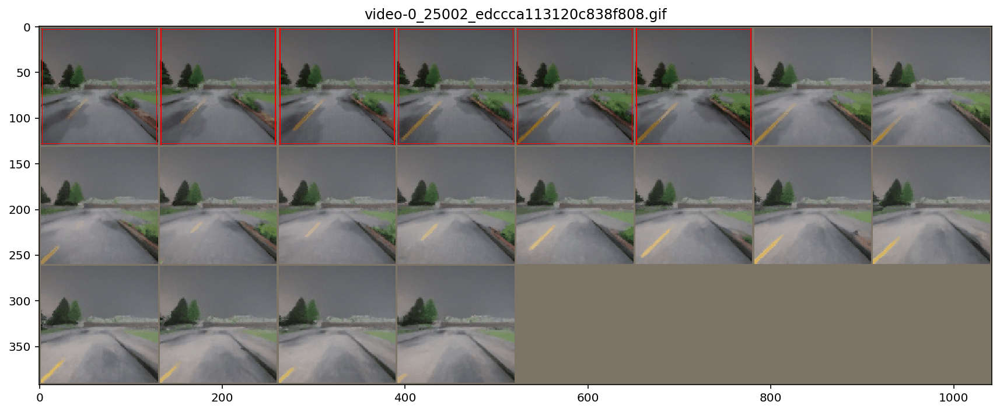

[[ 9.766617  22.565292 ]
 [ 9.7499695 21.537933 ]
 [ 7.4454193 22.221764 ]
 [ 9.413345  20.33657  ]
 [ 9.416138  20.26648  ]
 [ 8.046341  19.477394 ]
 [ 1.2612457 20.614471 ]
 [ 3.1339111 21.768784 ]
 [ 4.735382  24.208214 ]
 [ 4.328125  22.759262 ]
 [ 7.5781555 24.93293  ]
 [ 7.2800446 24.818848 ]
 [12.12854   22.432693 ]
 [18.41449   22.528702 ]
 [26.982025  22.795807 ]
 [28.007736  28.642456 ]
 [26.676315  24.55407  ]
 [23.54802   25.802185 ]
 [24.093628  22.245476 ]
 [23.527664  20.871536 ]]


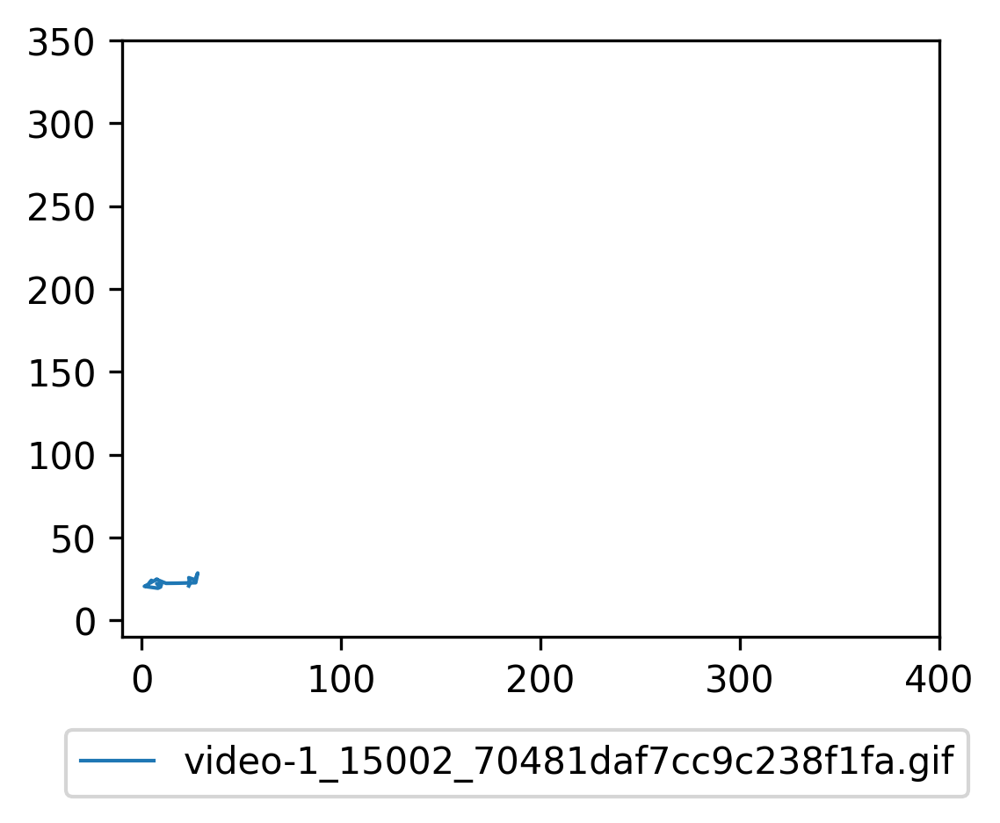

-------------------------------


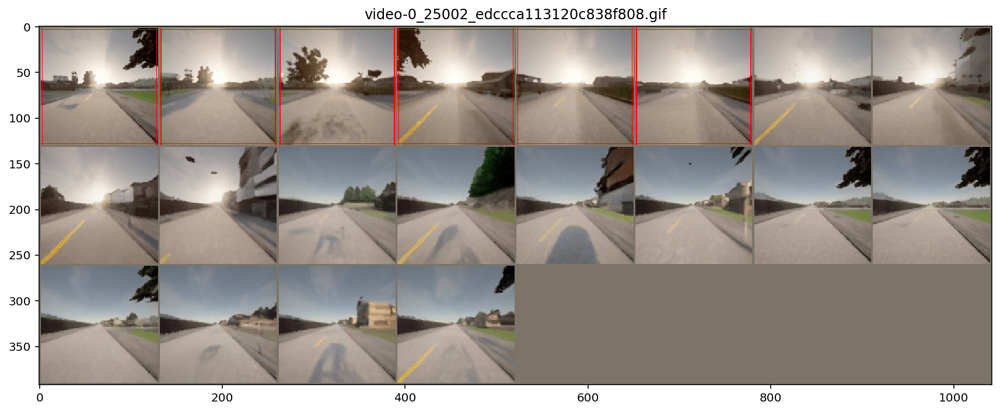

[[180.81491    54.191612 ]
 [165.87138    61.322533 ]
 [159.9516     55.437805 ]
 [141.41516    53.021202 ]
 [132.10844    54.012894 ]
 [115.90495    53.233994 ]
 [137.71353   128.69038  ]
 [245.33347   324.14282  ]
 [206.91586   255.95987  ]
 [162.86249   327.7202   ]
 [294.81616     3.222229 ]
 [314.51965     4.3095703]
 [213.10117     8.854584 ]
 [172.01736     4.345154 ]
 [188.87784     9.070663 ]
 [185.93633     8.855316 ]
 [158.46228     4.3359833]
 [157.9102      3.8968964]
 [205.12616     3.8431854]
 [231.0073      4.0859222]]


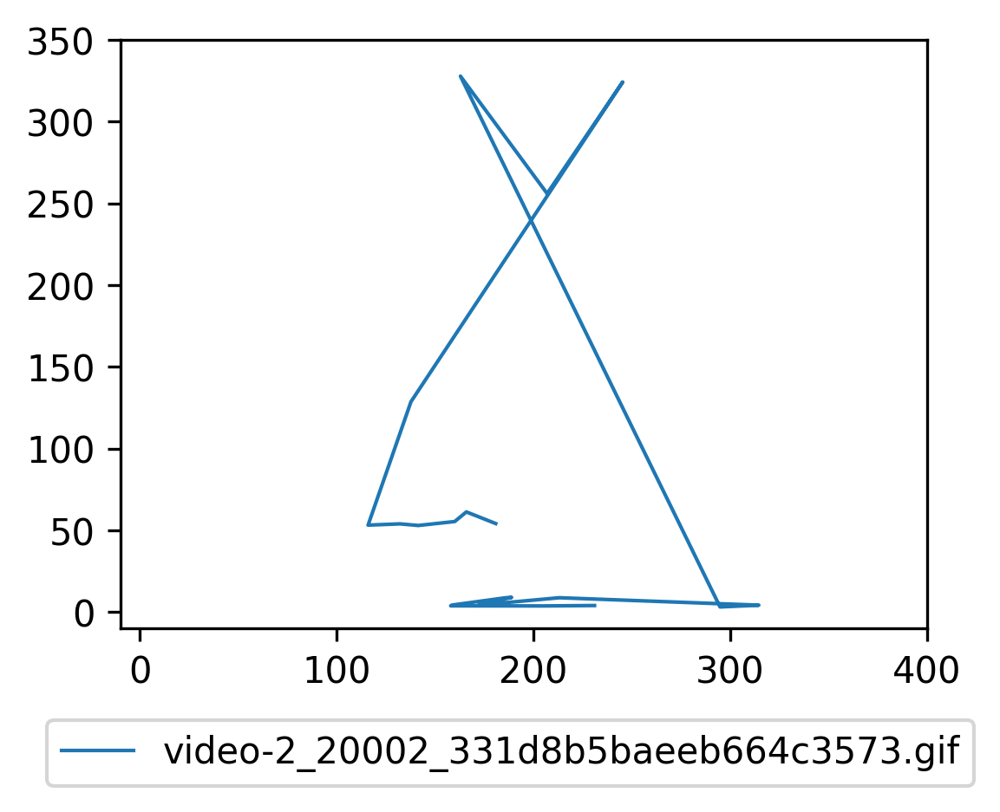

-------------------------------


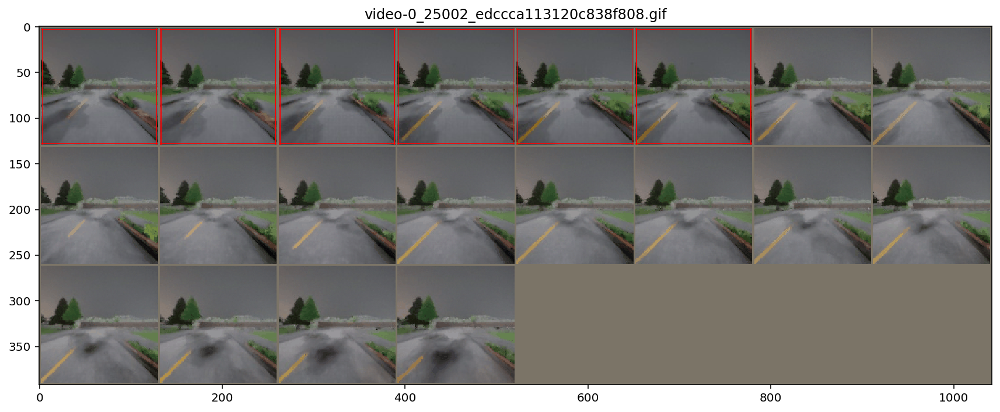

[[ 9.766617   22.565292  ]
 [ 9.7499695  21.537933  ]
 [ 7.4454193  22.221764  ]
 [ 9.413345   20.33657   ]
 [ 9.416138   20.26648   ]
 [ 8.046341   19.477394  ]
 [ 1.0221863  21.18679   ]
 [ 2.4853516  21.692574  ]
 [ 1.2560272  22.449028  ]
 [ 1.1791382  22.503014  ]
 [ 0.64276123 22.631989  ]
 [ 1.640213   23.110573  ]
 [ 1.8592834  23.102661  ]
 [ 2.6386108  21.200348  ]
 [ 2.482727   18.396362  ]
 [ 0.9621582  16.652512  ]
 [-0.22138977 17.285027  ]
 [-1.3587494  16.553322  ]
 [ 0.69369507 17.524406  ]
 [ 0.05226135 18.18486   ]]


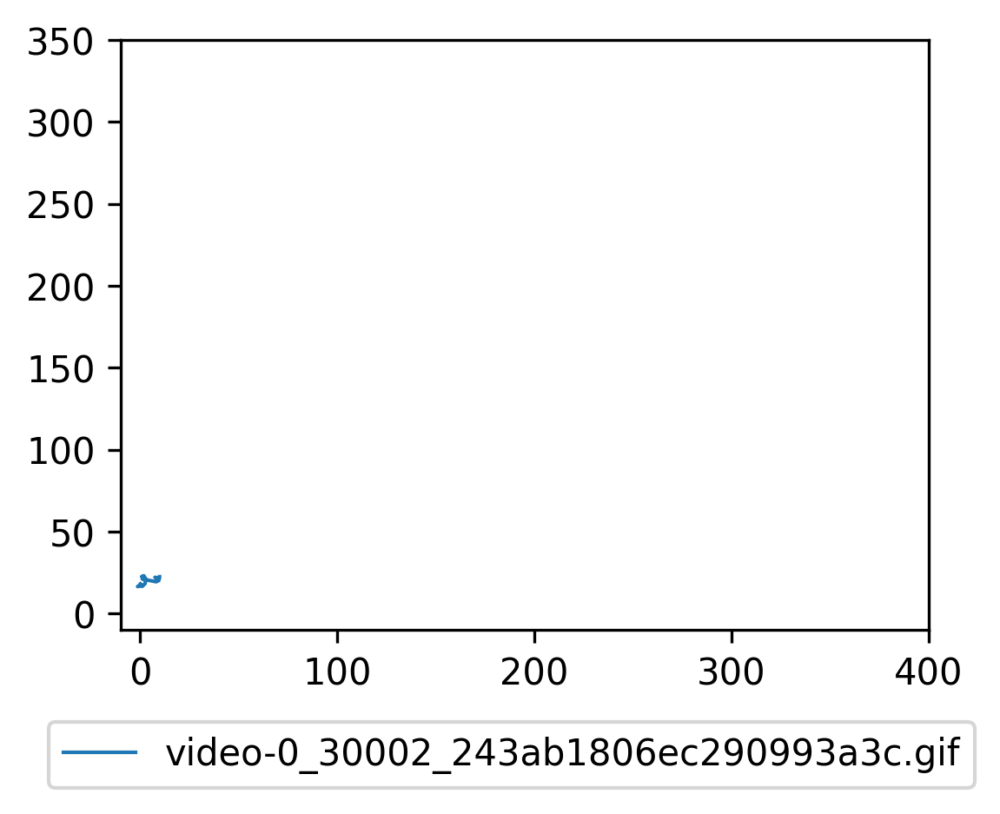

-------------------------------


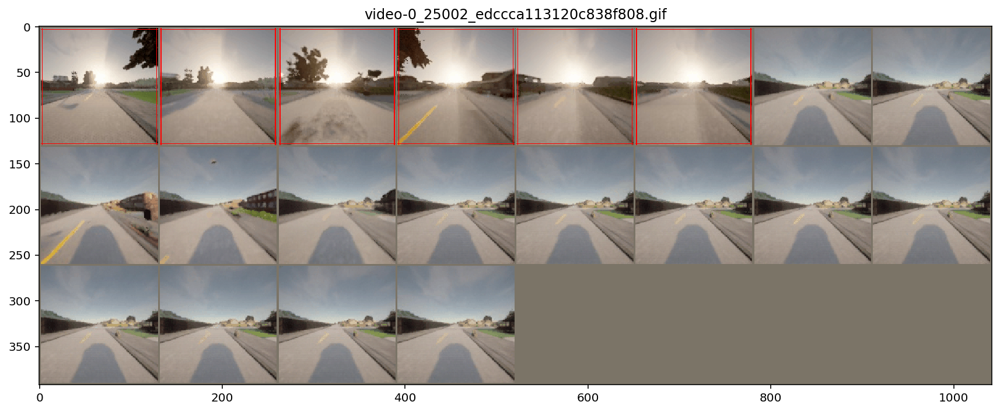

[[180.81491    54.191612 ]
 [165.87138    61.322533 ]
 [159.9516     55.437805 ]
 [141.41516    53.021202 ]
 [132.10844    54.012894 ]
 [115.90495    53.233994 ]
 [ 68.01029     2.5675354]
 [ 68.77711     2.0508728]
 [ 44.568237    1.6910248]
 [ 47.42109     2.2546234]
 [ 73.86801     4.172943 ]
 [ 68.84758     2.0308838]
 [ 67.97402     1.7451782]
 [ 69.02912     2.11734  ]
 [ 68.96157     2.0152435]
 [ 68.068924    2.0343933]
 [ 68.25106     1.7648468]
 [ 67.71979     1.6690063]
 [ 67.59975     1.3558655]
 [ 69.26326     1.9255981]]


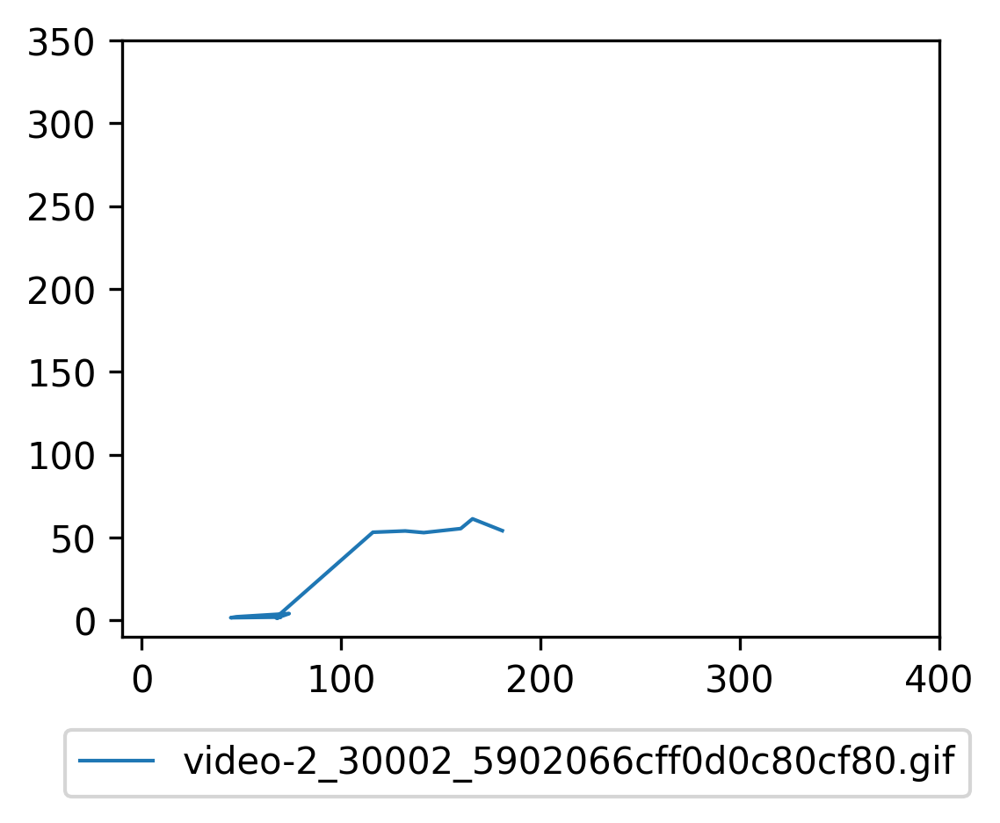

-------------------------------


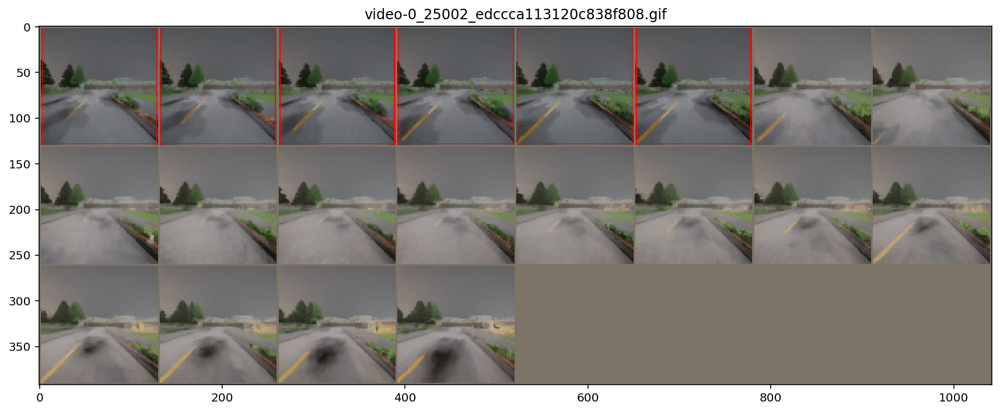

[[ 9.766617   22.565292  ]
 [ 9.7499695  21.537933  ]
 [ 7.4454193  22.221764  ]
 [ 9.413345   20.33657   ]
 [ 9.416138   20.26648   ]
 [ 8.046341   19.477394  ]
 [-0.21881104 22.093987  ]
 [ 1.2341614  21.562881  ]
 [ 4.7156067  24.05719   ]
 [ 3.7543945  26.040138  ]
 [ 2.3314514  25.109573  ]
 [ 2.6905212  26.656372  ]
 [ 1.6629791  25.499329  ]
 [ 3.8149567  26.872986  ]
 [ 0.46339417 25.086395  ]
 [-1.0395966  25.731201  ]
 [-2.4765625  24.601044  ]
 [-2.8932495  26.314682  ]
 [-3.5874634  26.286232  ]
 [-1.5137329  24.953072  ]]


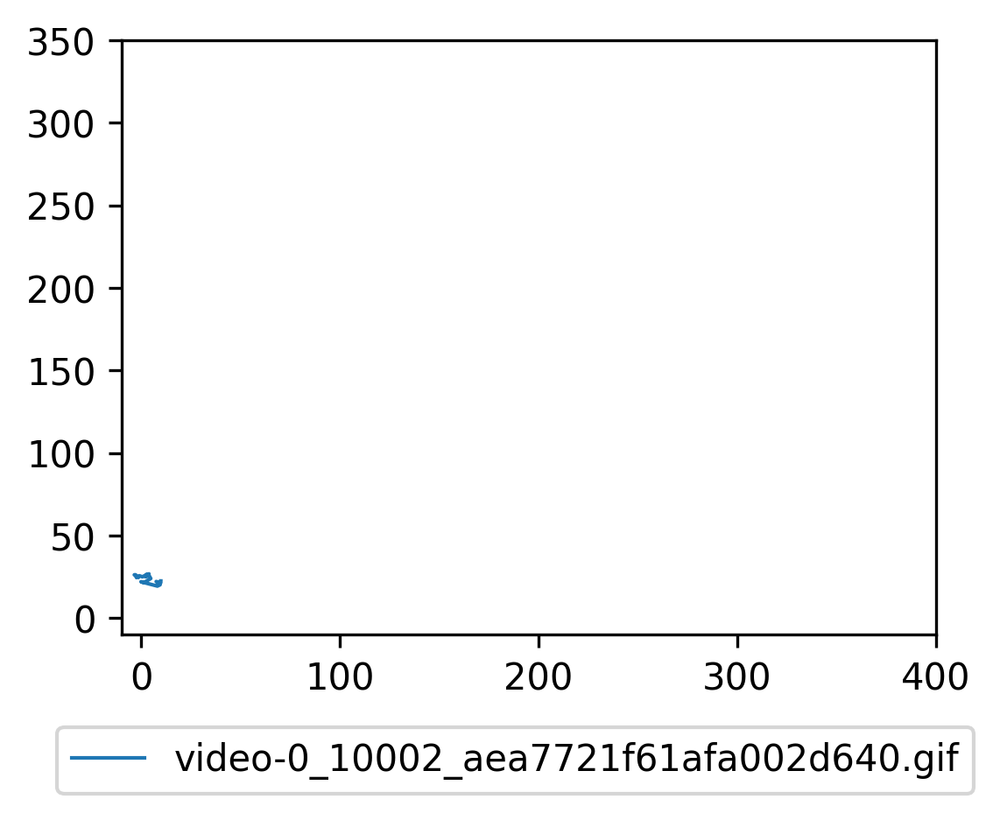

-------------------------------


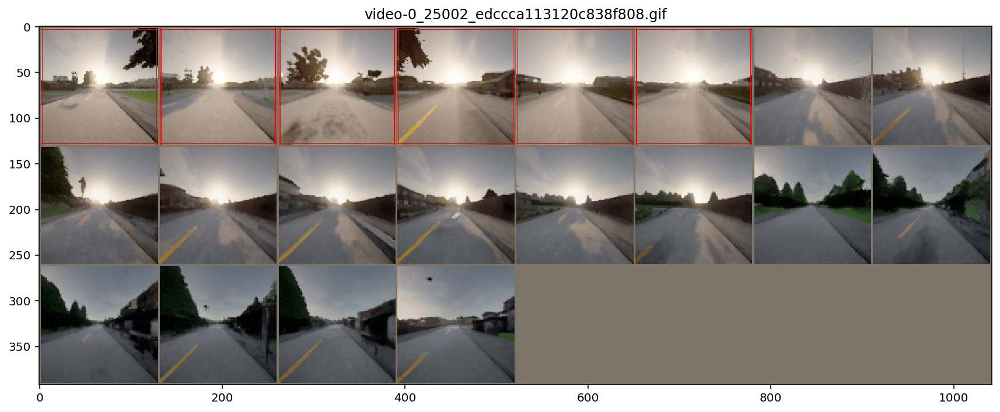

[[180.81491    54.191612 ]
 [165.87138    61.322533 ]
 [159.9516     55.437805 ]
 [141.41516    53.021202 ]
 [132.10844    54.012894 ]
 [115.90495    53.233994 ]
 [ 64.95799     5.9813995]
 [174.08197     7.1722717]
 [231.20712    37.901405 ]
 [106.15665     9.059616 ]
 [ 90.63863    30.609467 ]
 [ 47.9758     14.960564 ]
 [ 36.510666   -1.7297363]
 [ 22.805756   -0.8074646]
 [109.032104  182.89372  ]
 [109.1548    283.21954  ]
 [ 62.560997  280.60968  ]
 [ 73.333046  288.0784   ]
 [ 77.98933   260.5432   ]
 [ 94.61142   176.4421   ]]


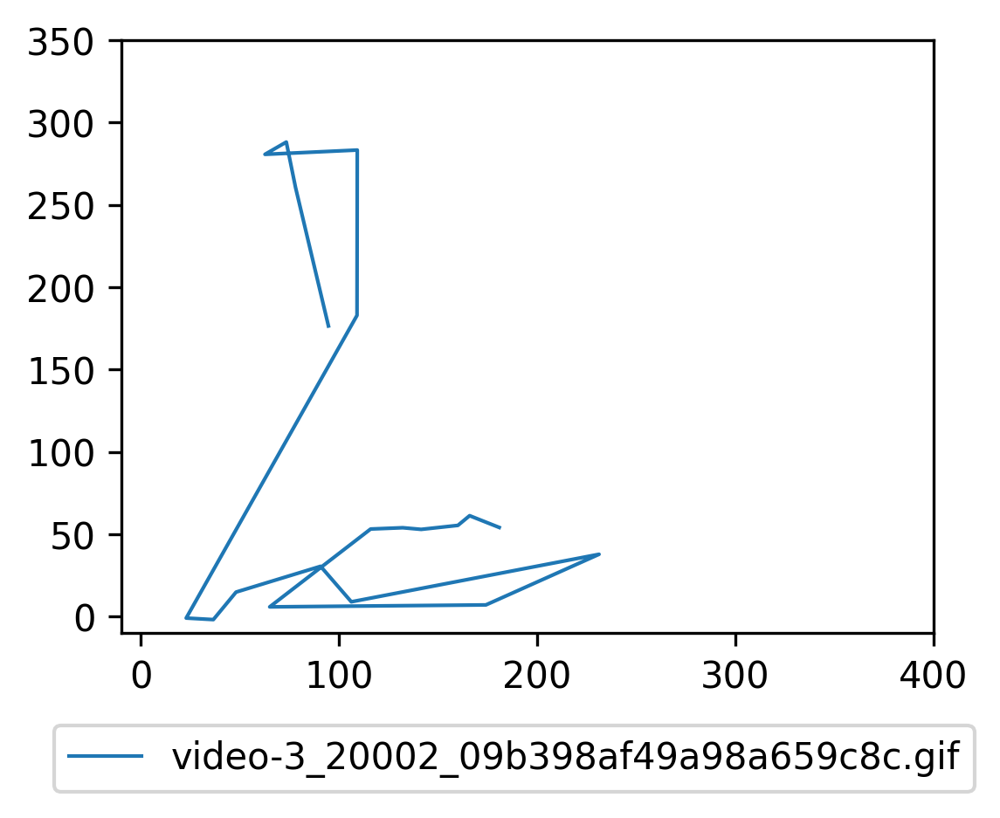

-------------------------------


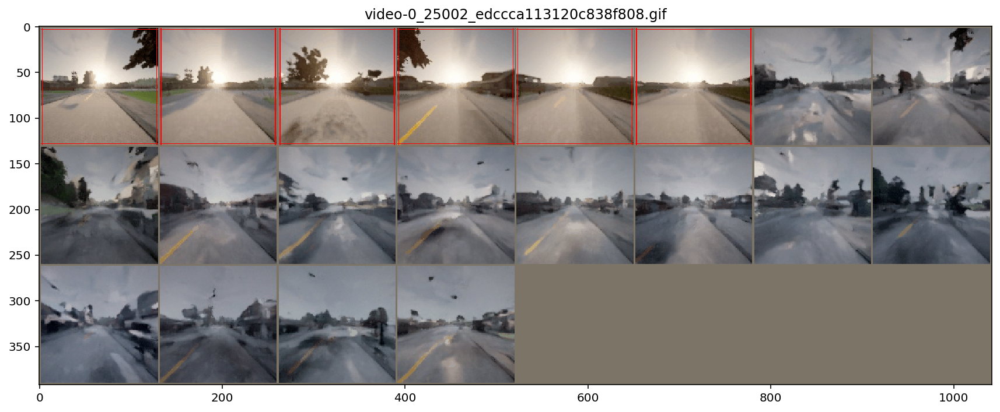

[[180.81491   54.191612]
 [165.87138   61.322533]
 [159.9516    55.437805]
 [141.41516   53.021202]
 [132.10844   54.012894]
 [115.90495   53.233994]
 [ 99.834946 210.09163 ]
 [104.752594 208.60236 ]
 [222.41273  270.91574 ]
 [102.00694  256.06677 ]
 [ 97.37424  206.93329 ]
 [ 93.37549  203.00764 ]
 [ 99.57381  183.06985 ]
 [ 87.87074  200.31909 ]
 [144.64081  140.74216 ]
 [ 81.76774  247.9525  ]
 [ 89.09357  279.58963 ]
 [108.27252  211.07695 ]
 [ 82.72077  171.04324 ]
 [105.7144    72.29928 ]]


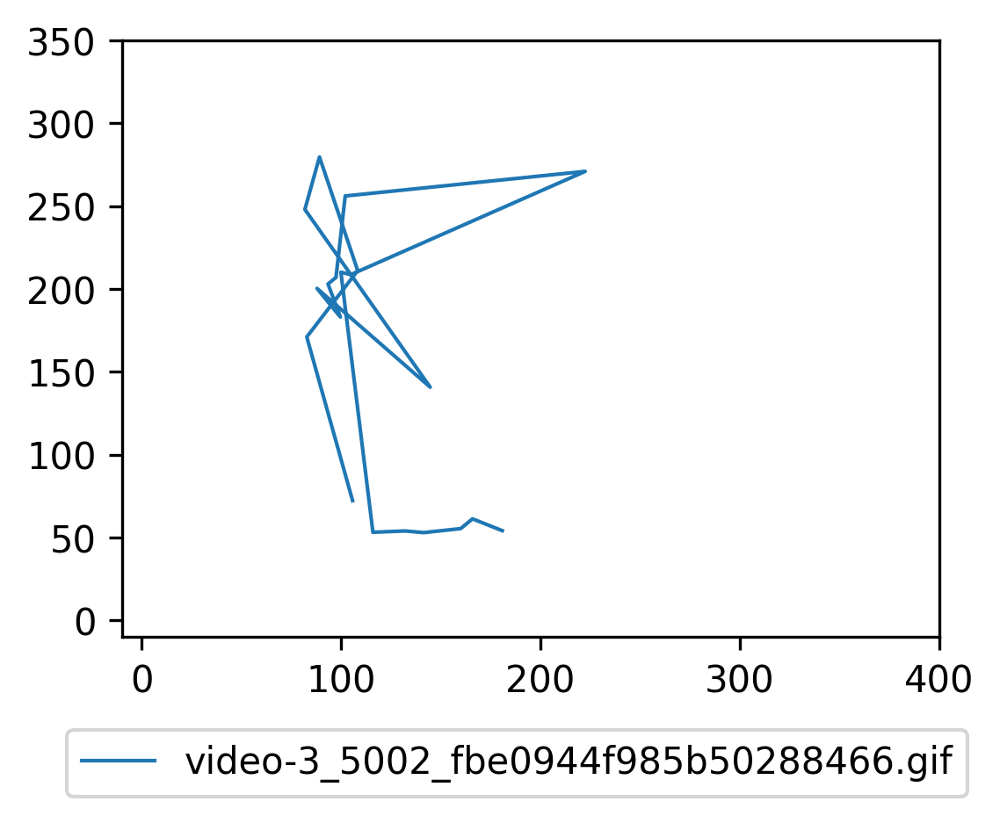

-------------------------------


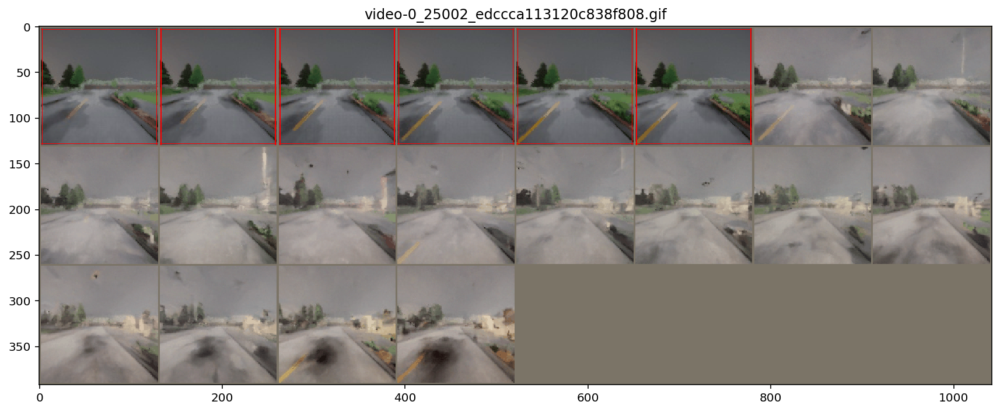

[[  9.766617   22.565292 ]
 [  9.7499695  21.537933 ]
 [  7.4454193  22.221764 ]
 [  9.413345   20.33657  ]
 [  9.416138   20.26648  ]
 [  8.046341   19.477394 ]
 [ 31.030746   24.727219 ]
 [ 27.474792   22.931976 ]
 [ 55.61299    32.894928 ]
 [118.02734   114.22524  ]
 [ 77.50816   158.07912  ]
 [ 49.519455   75.152374 ]
 [ 78.0601     43.82351  ]
 [116.903435   47.548912 ]
 [116.64018    53.583855 ]
 [ 43.978783   65.06673  ]
 [ 26.280396   33.243767 ]
 [ 62.35871    62.323242 ]
 [ 94.68153   123.60359  ]
 [ 66.68976   120.17734  ]]


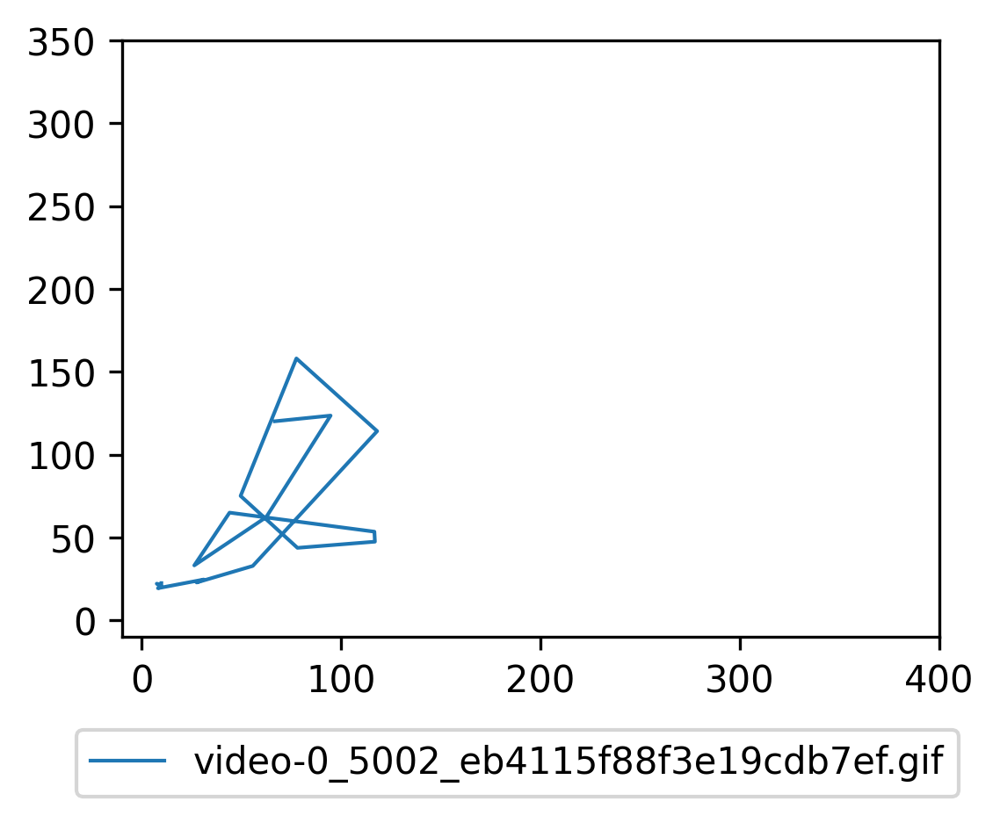

-------------------------------


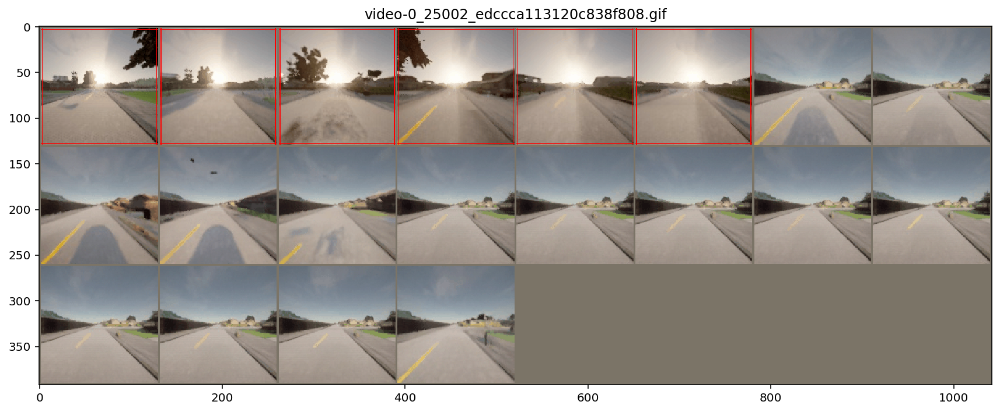

[[180.81491    54.191612 ]
 [165.87138    61.322533 ]
 [159.9516     55.437805 ]
 [141.41516    53.021202 ]
 [132.10844    54.012894 ]
 [115.90495    53.233994 ]
 [ 67.494064    2.3954468]
 [ 68.99053     2.6915283]
 [ 71.5453      2.3053436]
 [148.80005     1.8831024]
 [ 61.924263    2.0335083]
 [ 69.43635     2.4912872]
 [ 69.19655     2.6516113]
 [ 69.02415     2.9122162]
 [ 69.320984    2.8484192]
 [ 69.231346    2.9476013]
 [ 68.46347     2.6108704]
 [ 68.6323      2.5084534]
 [ 68.805725    2.6598969]
 [ 82.38403     4.22348  ]]


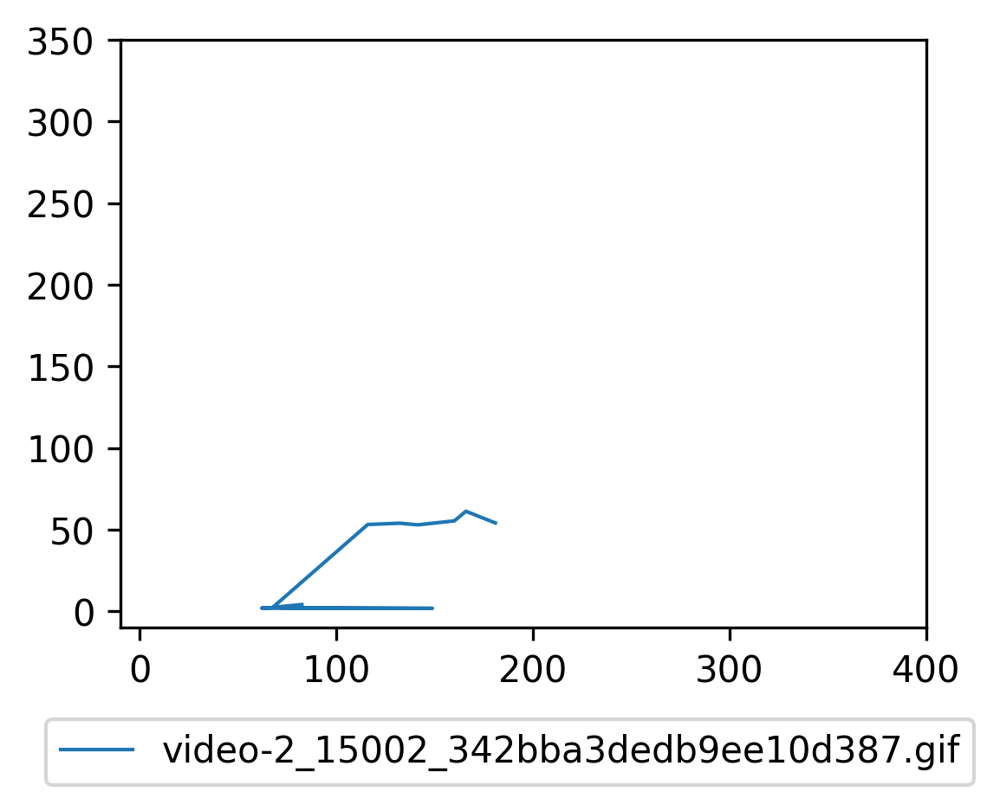

-------------------------------


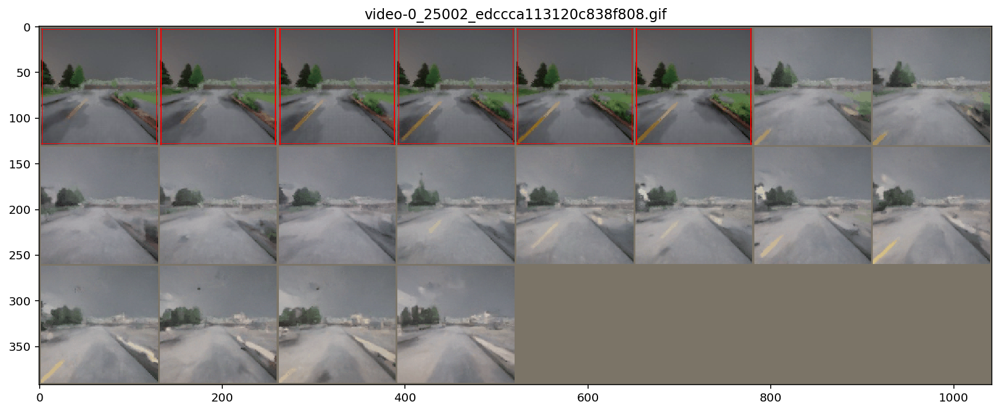

[[  9.766617   22.565292 ]
 [  9.7499695  21.537933 ]
 [  7.4454193  22.221764 ]
 [  9.413345   20.33657  ]
 [  9.416138   20.26648  ]
 [  8.046341   19.477394 ]
 [ 16.729385   28.708145 ]
 [ 16.9225     25.735832 ]
 [ 46.529274   40.730606 ]
 [ 41.793137   45.997192 ]
 [ 55.414192   63.70775  ]
 [ 42.42694    87.37096  ]
 [ 66.69031    70.104965 ]
 [ 59.05313    85.1704   ]
 [ 93.88694   168.8114   ]
 [ 99.69333   178.50624  ]
 [ 78.363754  120.458755 ]
 [ 60.951927  140.5991   ]
 [ 37.941467  123.35176  ]
 [ 59.646317  181.31273  ]]


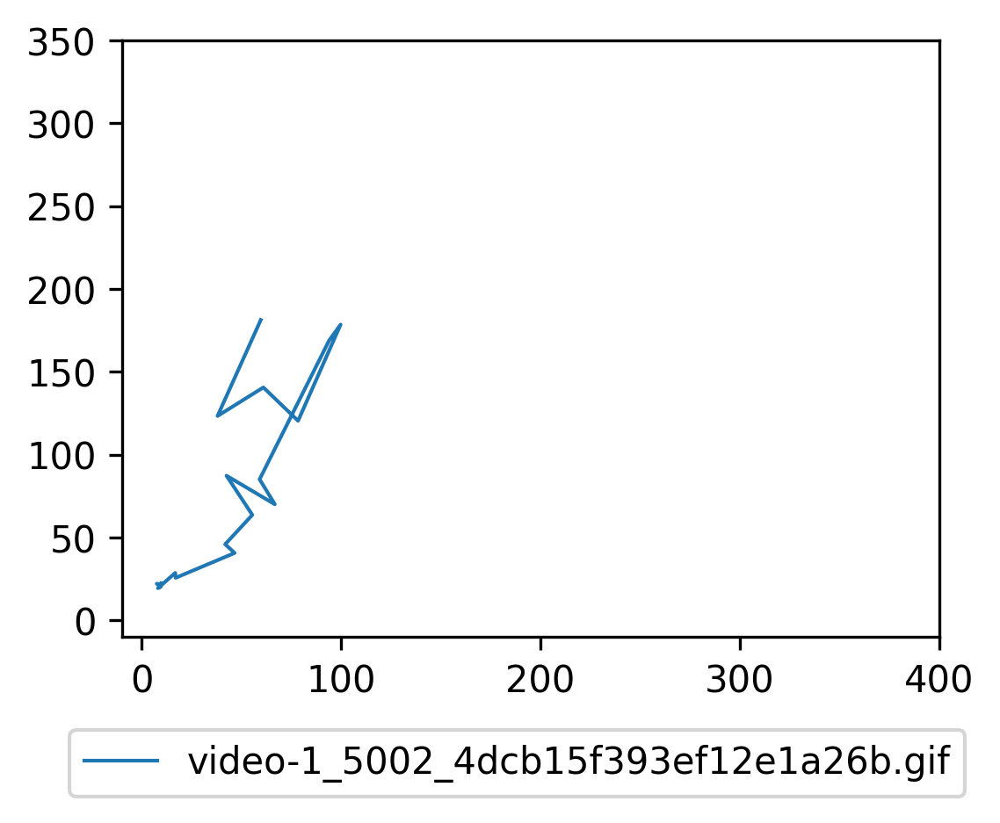

-------------------------------


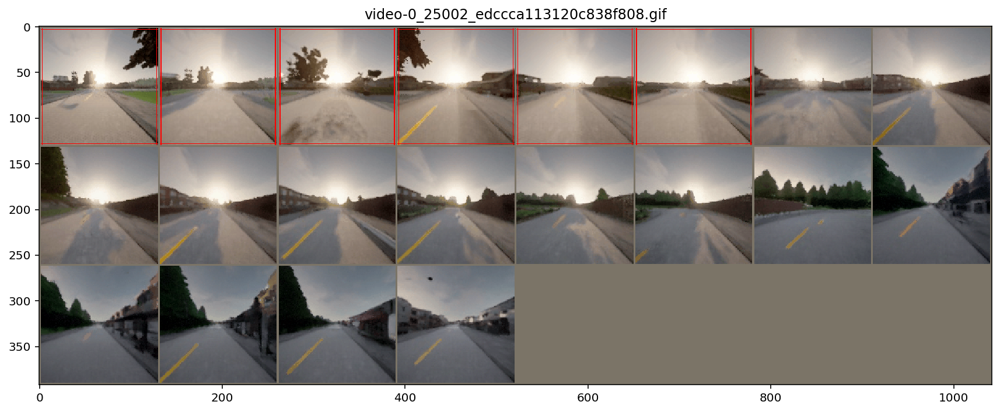

[[180.81491     54.191612  ]
 [165.87138     61.322533  ]
 [159.9516      55.437805  ]
 [141.41516     53.021202  ]
 [132.10844     54.012894  ]
 [115.90495     53.233994  ]
 [ 86.15787     47.515686  ]
 [ 56.041695    -0.99076843]
 [196.43922      4.5277405 ]
 [ 61.701782    -0.519104  ]
 [ 45.673462     2.9266205 ]
 [ 39.539482     7.0681915 ]
 [ 28.062637    -1.2852173 ]
 [ 19.90477     -1.5643005 ]
 [ 13.728653   287.96378   ]
 [  3.860077   303.3058    ]
 [  2.9107056  292.9956    ]
 [ 22.364944   292.8562    ]
 [ 32.883507   275.9674    ]
 [ 92.72096    273.9989    ]]


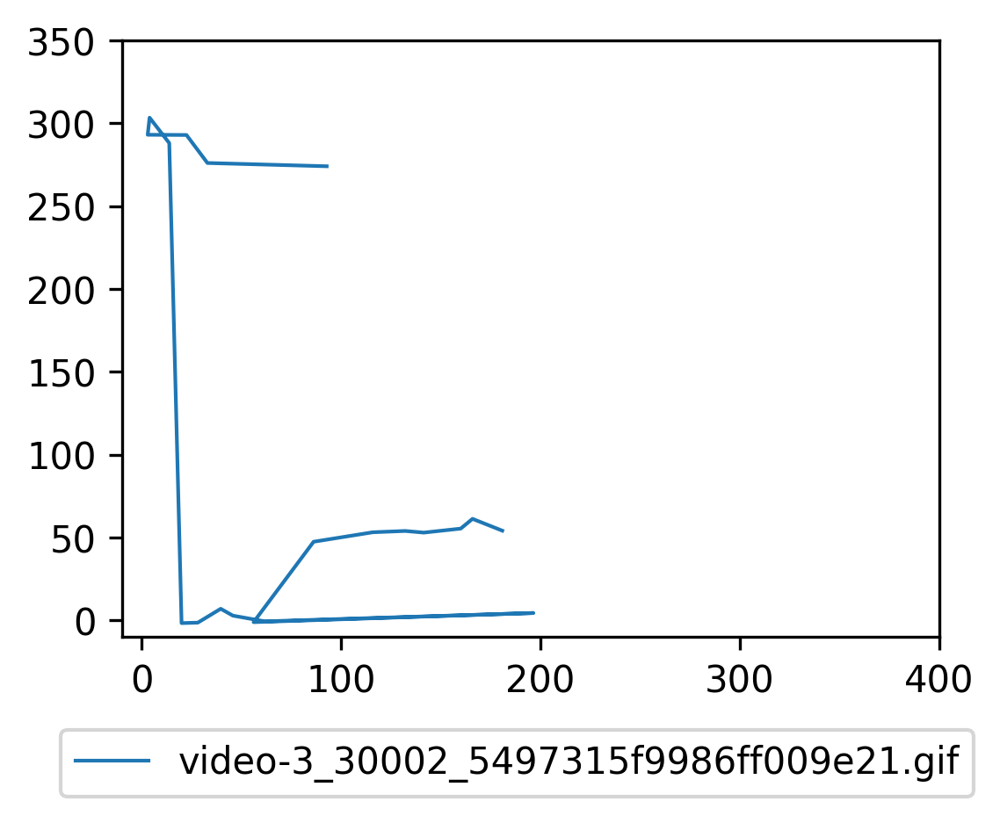

-------------------------------


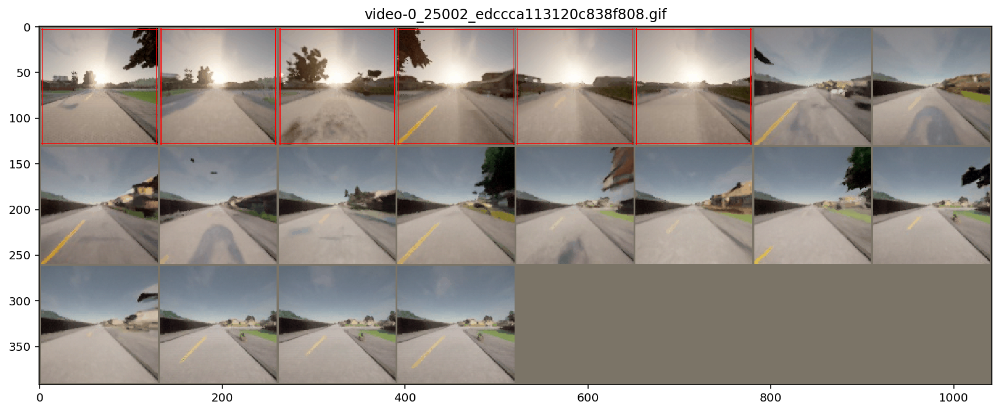

[[180.81491    54.191612 ]
 [165.87138    61.322533 ]
 [159.9516     55.437805 ]
 [141.41516    53.021202 ]
 [132.10844    54.012894 ]
 [115.90495    53.233994 ]
 [ 86.95949    18.810928 ]
 [142.89326     2.1187134]
 [149.27927     2.1689453]
 [165.59018     4.4456787]
 [182.75327    10.366486 ]
 [175.32375     9.235901 ]
 [153.18164     7.3024597]
 [154.02748     1.98172  ]
 [150.41896     7.680542 ]
 [116.68352     3.6313019]
 [ 95.01434     5.9570007]
 [ 69.6417      2.7185516]
 [ 69.40836     2.7728577]
 [ 69.94476     2.5802002]]


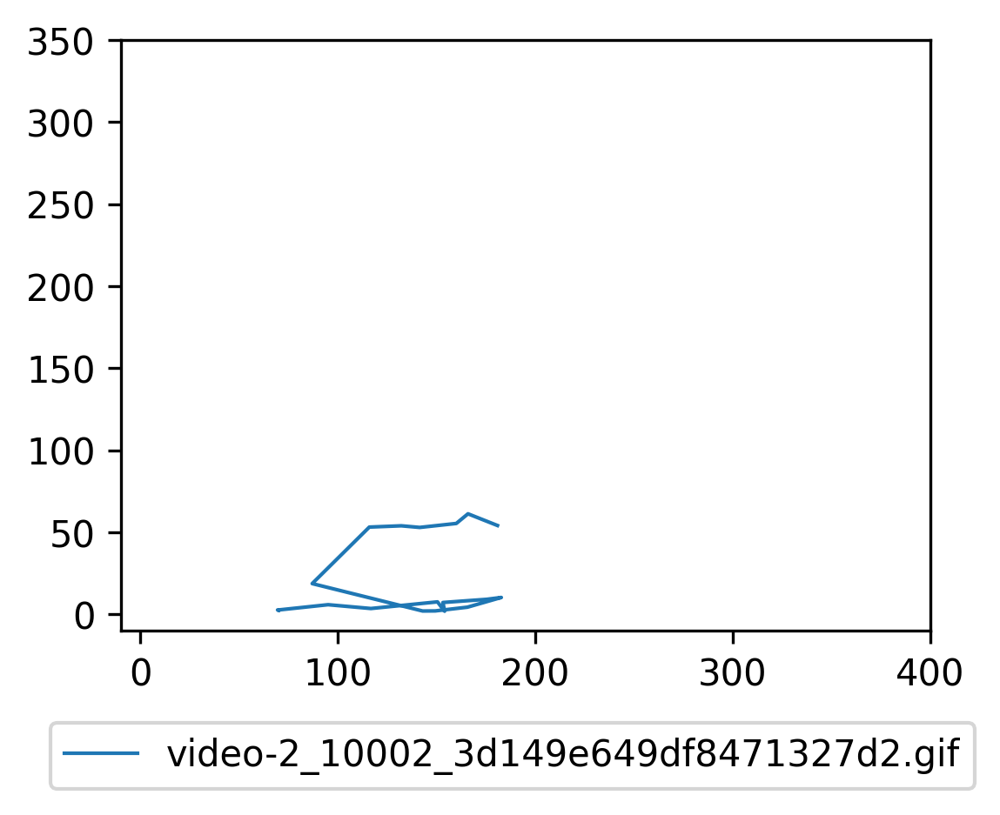

-------------------------------


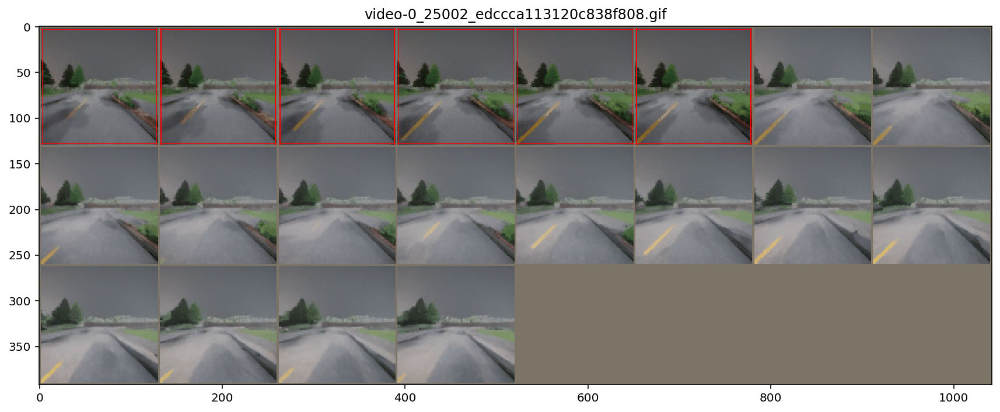

[[ 9.766617   22.565292  ]
 [ 9.7499695  21.537933  ]
 [ 7.4454193  22.221764  ]
 [ 9.413345   20.33657   ]
 [ 9.416138   20.26648   ]
 [ 8.046341   19.477394  ]
 [ 0.56781006 20.920158  ]
 [ 3.0312958  21.252068  ]
 [ 3.9491272  23.396477  ]
 [ 7.4349976  23.119888  ]
 [13.444672   23.572258  ]
 [15.491577   24.71138   ]
 [18.634415   23.844498  ]
 [29.569313   23.205597  ]
 [37.42639    27.964622  ]
 [45.347122   34.75614   ]
 [43.477844   32.111435  ]
 [47.113113   33.517014  ]
 [44.280945   32.305763  ]
 [42.70642    33.298798  ]]


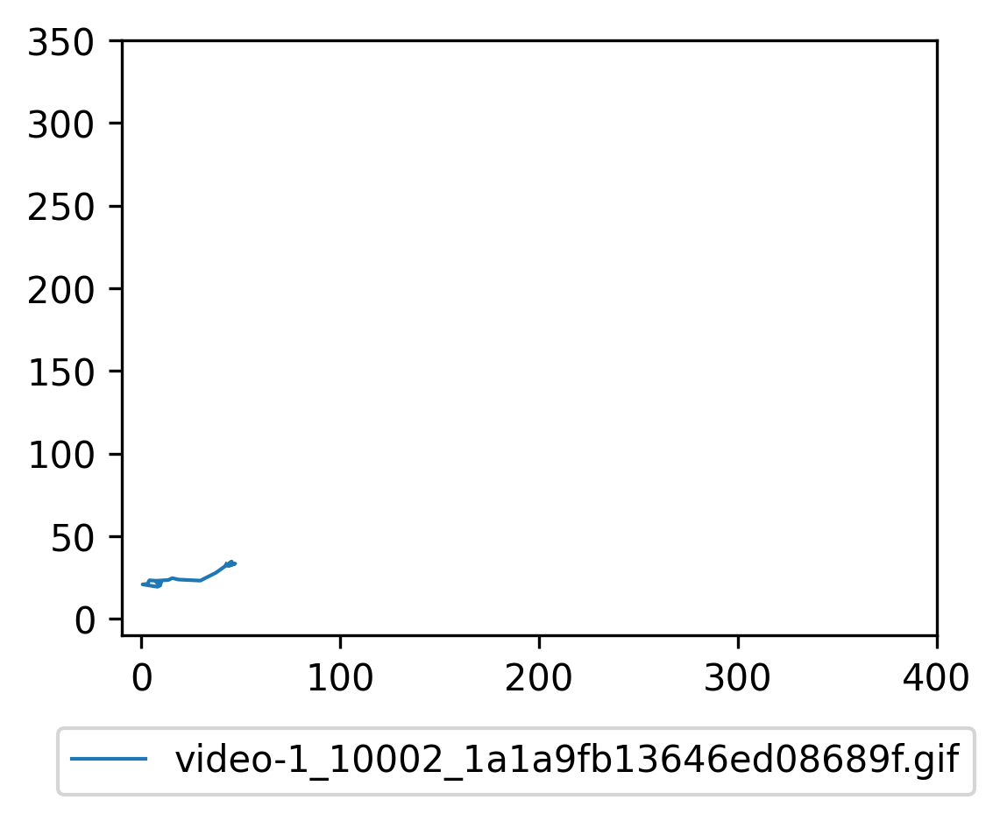

-------------------------------


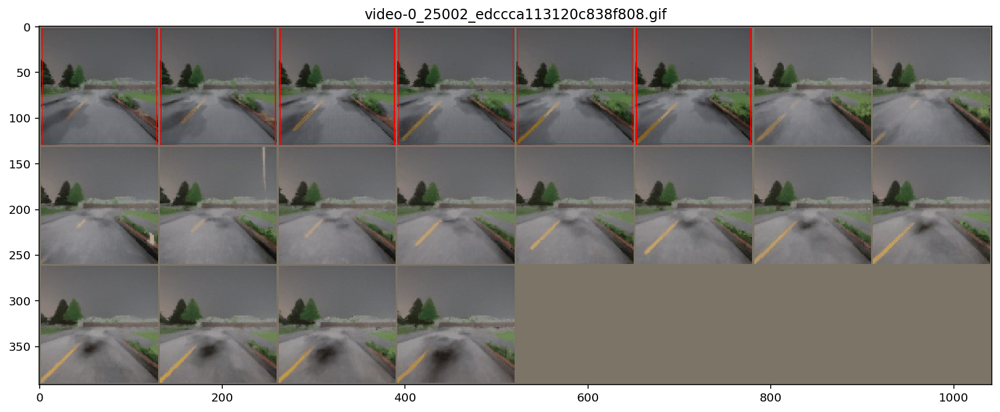

[[ 9.766617   22.565292  ]
 [ 9.7499695  21.537933  ]
 [ 7.4454193  22.221764  ]
 [ 9.413345   20.33657   ]
 [ 9.416138   20.26648   ]
 [ 8.046341   19.477394  ]
 [ 0.287735   21.172554  ]
 [ 1.6064758  21.250221  ]
 [ 1.9765015  21.046928  ]
 [ 1.5649261  22.523216  ]
 [ 2.1929626  23.654648  ]
 [ 2.0241547  24.024338  ]
 [ 1.553421   24.297462  ]
 [ 2.7303925  22.803635  ]
 [ 2.640213   21.190994  ]
 [ 2.401352   20.862259  ]
 [ 0.60969543 18.356125  ]
 [-1.4756165  17.371063  ]
 [ 1.4560852  18.894638  ]
 [ 3.2772675  20.78563   ]]


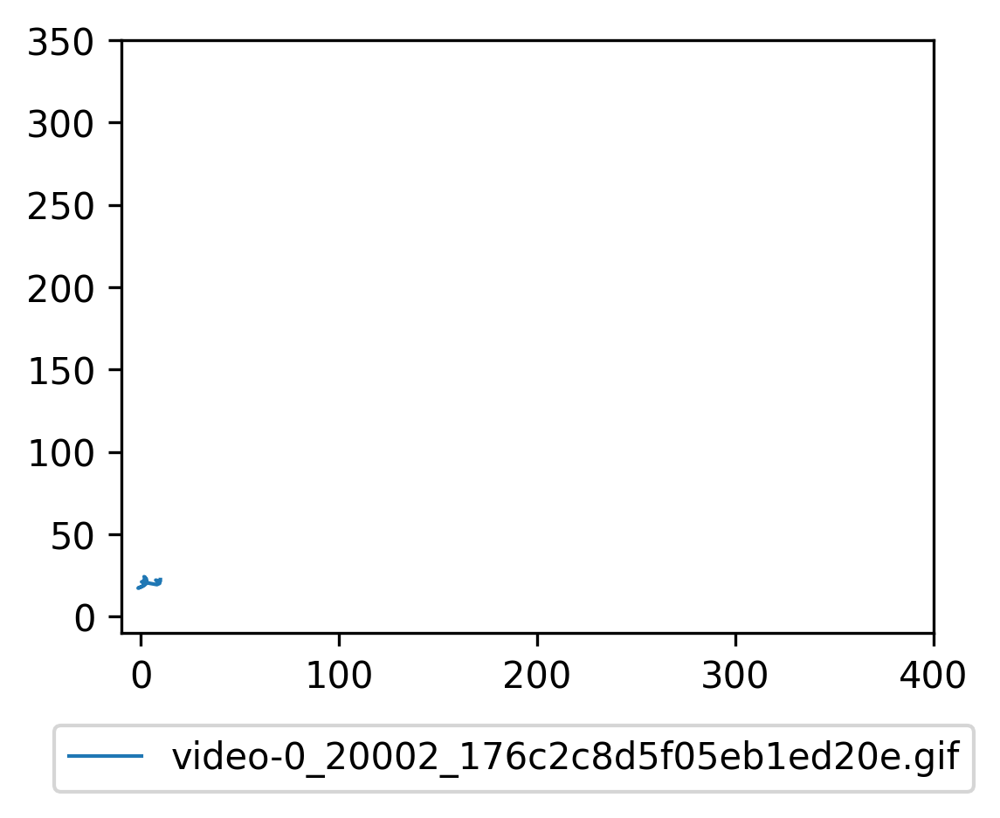

-------------------------------


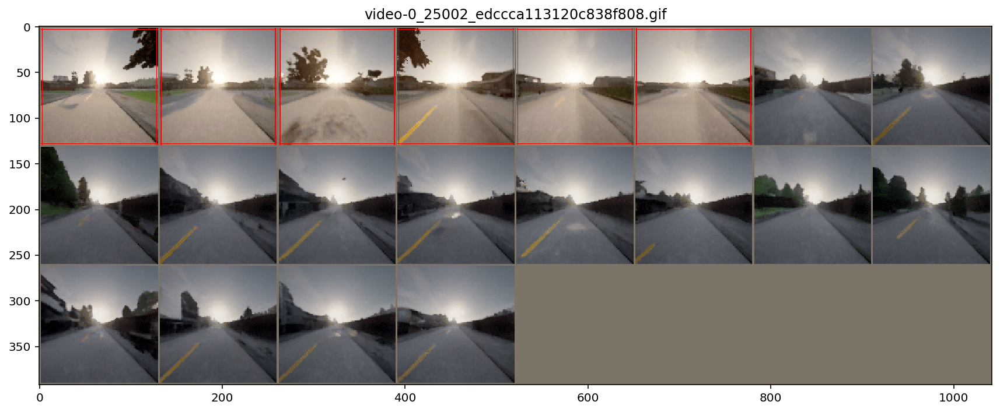

[[180.81491   54.191612]
 [165.87138   61.322533]
 [159.9516    55.437805]
 [141.41516   53.021202]
 [132.10844   54.012894]
 [115.90495   53.233994]
 [ 65.74764   36.246643]
 [157.79689  271.0058  ]
 [191.04309  244.46515 ]
 [167.17227  180.6603  ]
 [168.31946   87.64763 ]
 [155.9838   114.36499 ]
 [111.57187   65.22479 ]
 [134.18192   95.33789 ]
 [ 44.772354 238.71274 ]
 [ 91.90977  245.14041 ]
 [ 75.498085 269.5345  ]
 [ 74.442635 262.30994 ]
 [177.54326  217.0772  ]
 [118.0424    63.044098]]


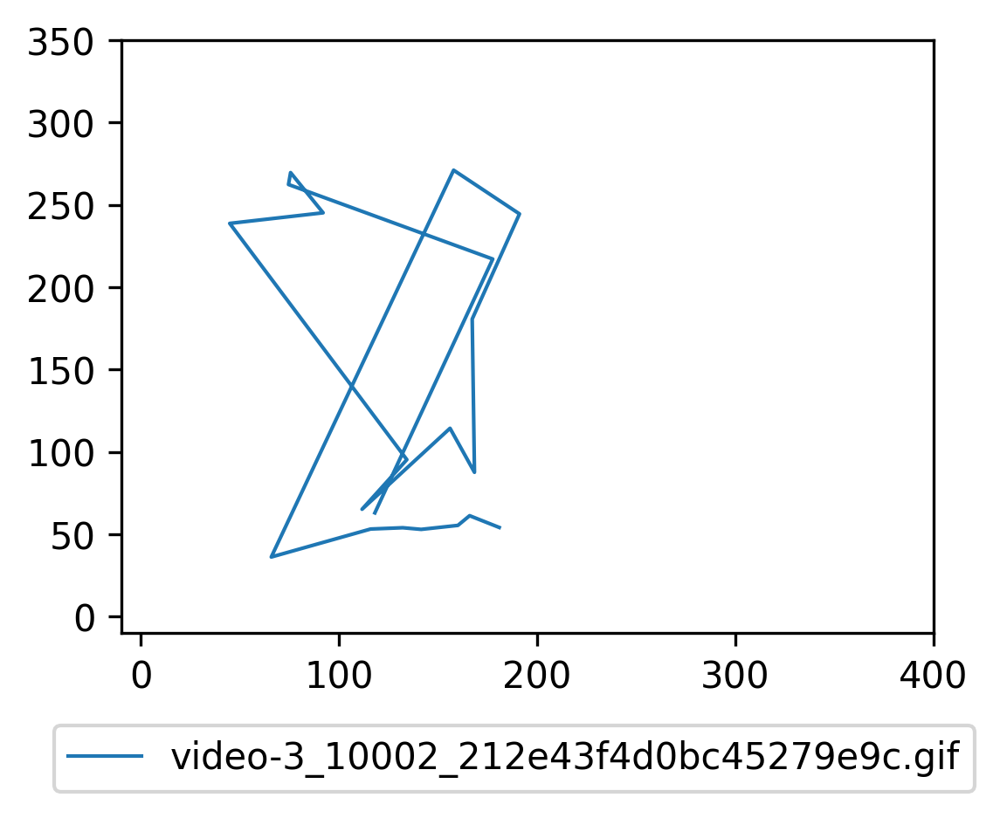

-------------------------------


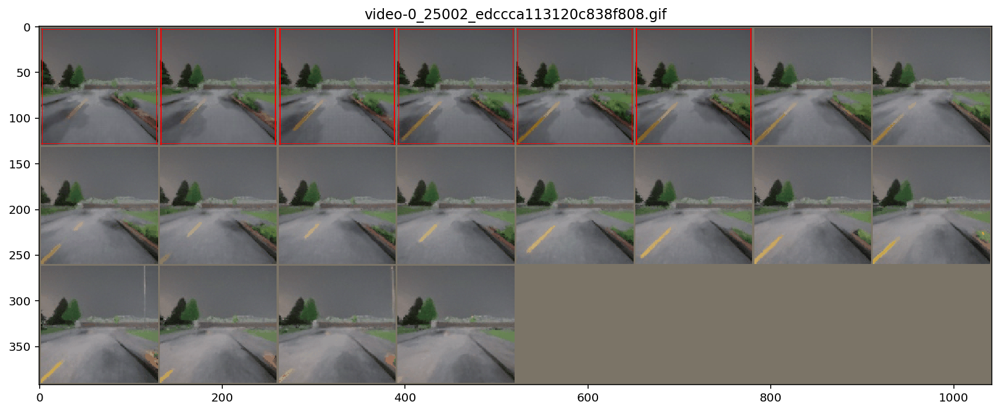

[[ 9.766617   22.565292  ]
 [ 9.7499695  21.537933  ]
 [ 7.4454193  22.221764  ]
 [ 9.413345   20.33657   ]
 [ 9.416138   20.26648   ]
 [ 8.046341   19.477394  ]
 [ 0.28388977 20.660652  ]
 [ 1.4782104  19.779434  ]
 [ 1.828598   21.504997  ]
 [ 3.858673   21.9049    ]
 [ 4.9348755  24.198616  ]
 [ 2.6303406  22.839874  ]
 [ 8.39267    22.321533  ]
 [13.816467   20.812256  ]
 [14.998581   22.398117  ]
 [21.281631   21.510628  ]
 [23.384338   23.268806  ]
 [18.911392   23.794037  ]
 [13.118042   20.895767  ]
 [14.093246   24.31717   ]]


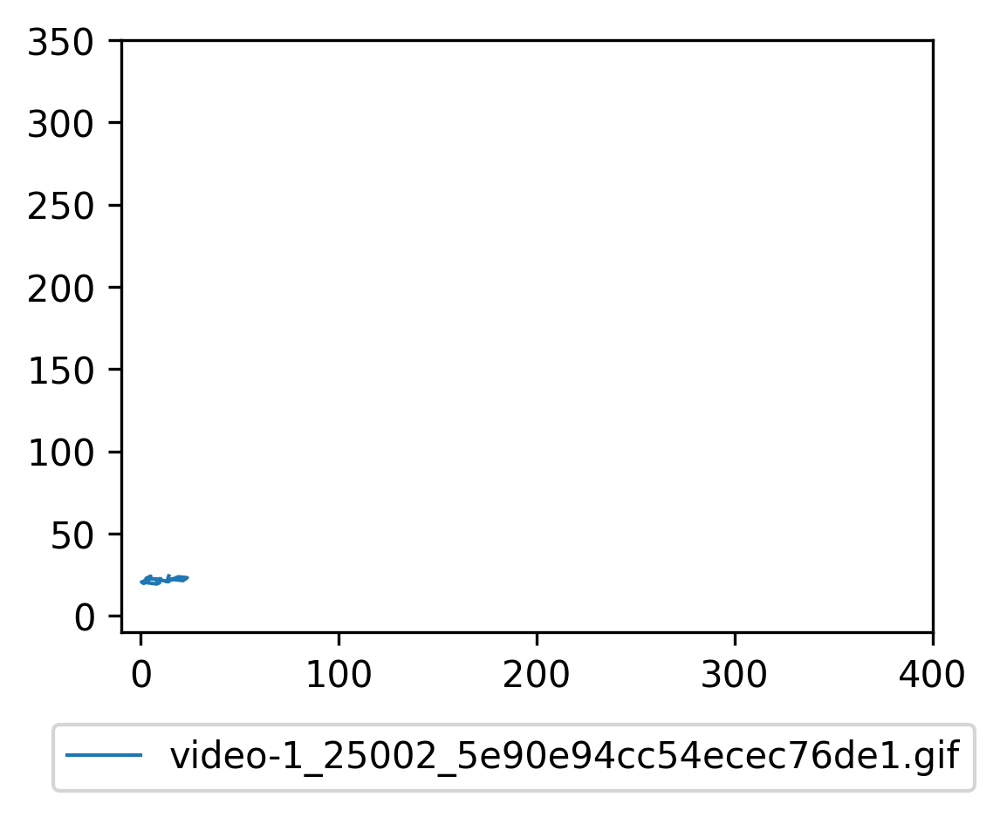

-------------------------------


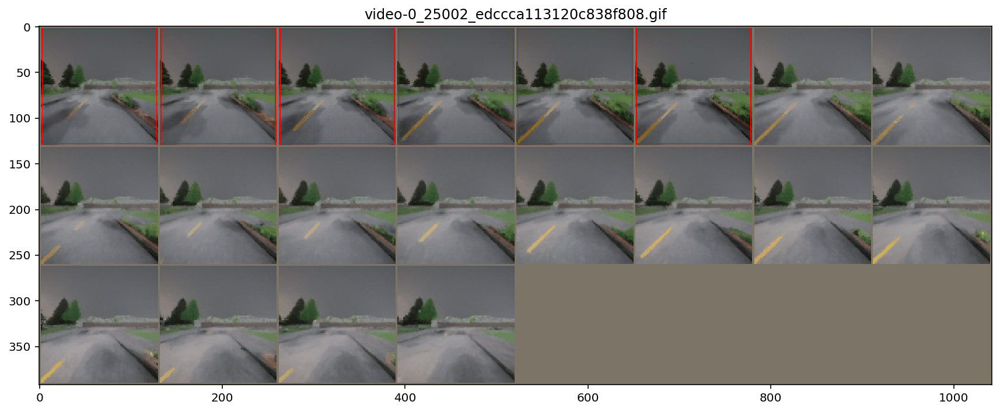

[[ 9.766617  22.565292 ]
 [ 9.7499695 21.537933 ]
 [ 7.4454193 22.221764 ]
 [ 9.413345  20.33657  ]
 [ 9.416138  20.26648  ]
 [ 8.046341  19.477394 ]
 [ 0.2498169 20.434135 ]
 [ 1.1767731 20.208252 ]
 [ 1.785675  21.357178 ]
 [ 4.0724792 21.177307 ]
 [ 4.8934326 24.278435 ]
 [ 4.163162  24.492302 ]
 [ 5.6912994 24.71885  ]
 [13.349243  22.96862  ]
 [16.857666  22.874603 ]
 [20.191101  23.975792 ]
 [18.434036  21.030289 ]
 [23.380829  22.16655  ]
 [18.562485  20.411705 ]
 [15.345886  20.695953 ]]


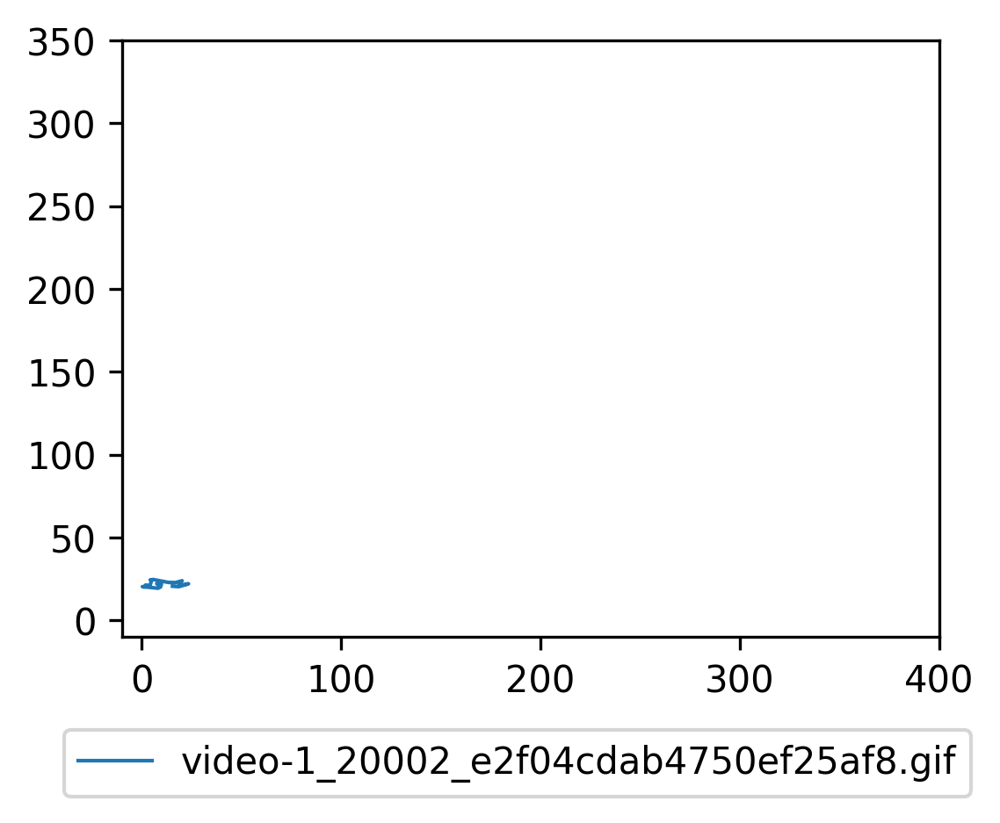

-------------------------------


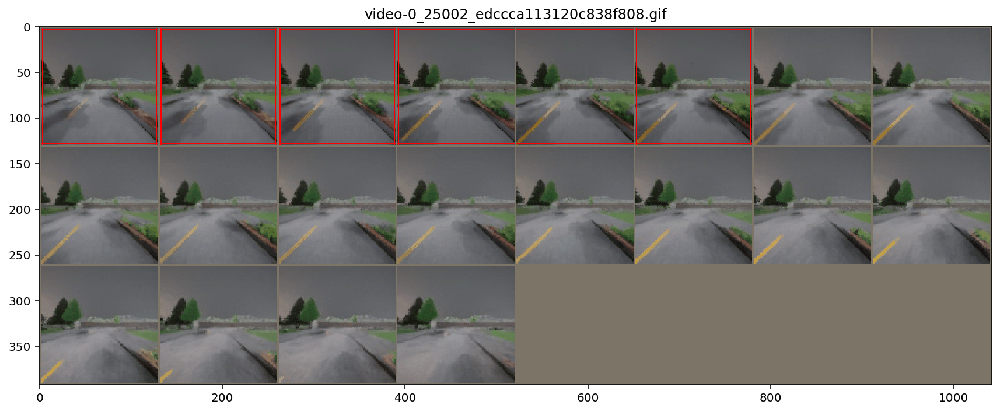

[[ 9.766617   22.565292  ]
 [ 9.7499695  21.537933  ]
 [ 7.4454193  22.221764  ]
 [ 9.413345   20.33657   ]
 [ 9.416138   20.26648   ]
 [ 8.046341   19.477394  ]
 [ 0.91270447 21.196167  ]
 [ 1.6515656  20.684578  ]
 [ 0.72795105 21.140198  ]
 [ 3.8443146  21.311401  ]
 [ 1.3043518  22.5671    ]
 [ 0.30093384 21.097092  ]
 [ 1.7164307  22.481056  ]
 [ 5.649933   22.825668  ]
 [ 9.781525   21.98661   ]
 [15.426392   19.897354  ]
 [14.740646   21.651855  ]
 [10.843201   21.060356  ]
 [12.618942   19.530838  ]
 [ 9.885178   20.929672  ]]


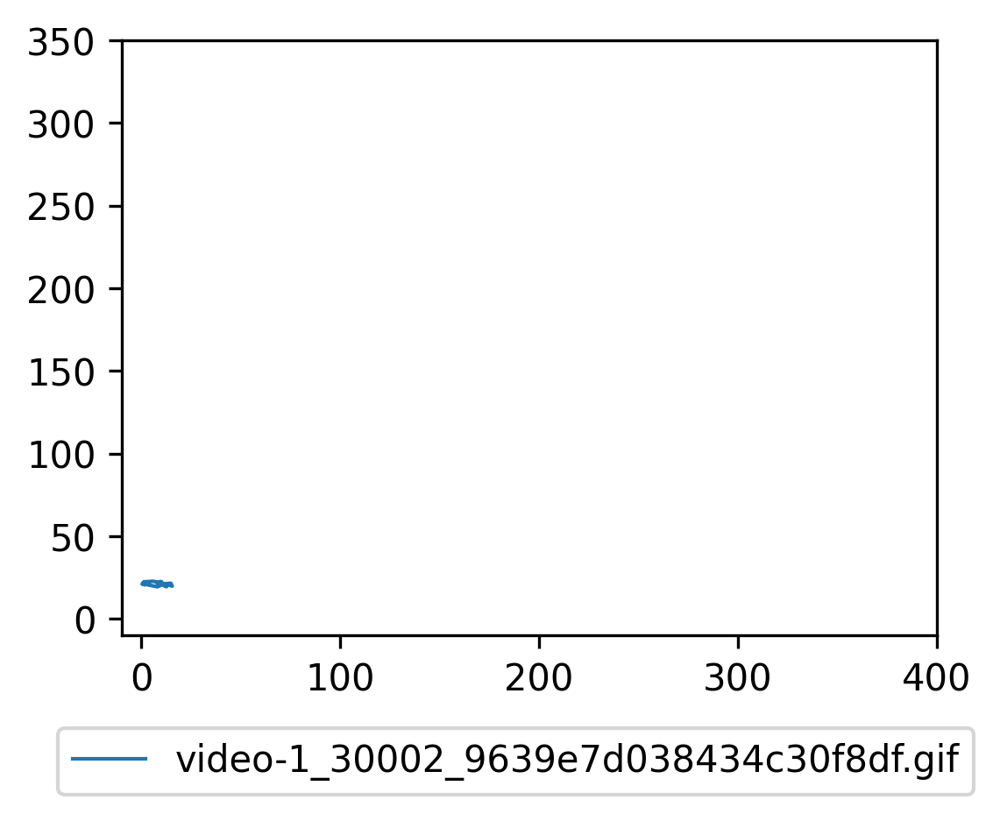

-------------------------------


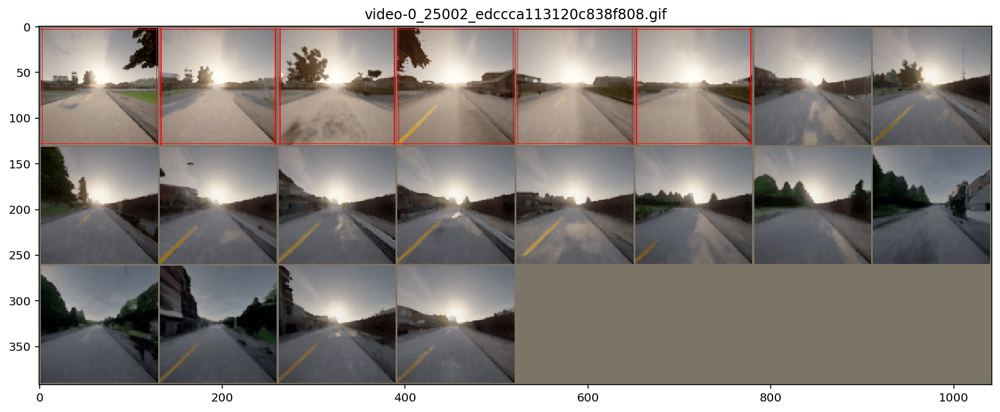

[[ 1.80814911e+02  5.41916122e+01]
 [ 1.65871384e+02  6.13225327e+01]
 [ 1.59951599e+02  5.54378052e+01]
 [ 1.41415161e+02  5.30212021e+01]
 [ 1.32108444e+02  5.40128937e+01]
 [ 1.15904953e+02  5.32339935e+01]
 [ 7.74024277e+01  1.94446030e+01]
 [ 2.07240753e+02  8.42088013e+01]
 [ 2.73584534e+02  6.26066437e+01]
 [ 1.21263176e+02  8.42791748e+00]
 [ 1.24305649e+02  2.21382370e+01]
 [ 5.21140518e+01  3.35691833e+00]
 [ 4.83852921e+01 -2.75820923e+00]
 [ 2.48141937e+01 -8.75167847e-01]
 [ 1.80787659e+00  1.32668121e+02]
 [ 8.57019043e+00  3.08521851e+02]
 [ 5.16504364e+01  2.79884094e+02]
 [ 9.84821396e+01  2.81818817e+02]
 [ 1.21500267e+02  4.72383499e+01]
 [ 5.09009552e+01  1.79397583e-01]]


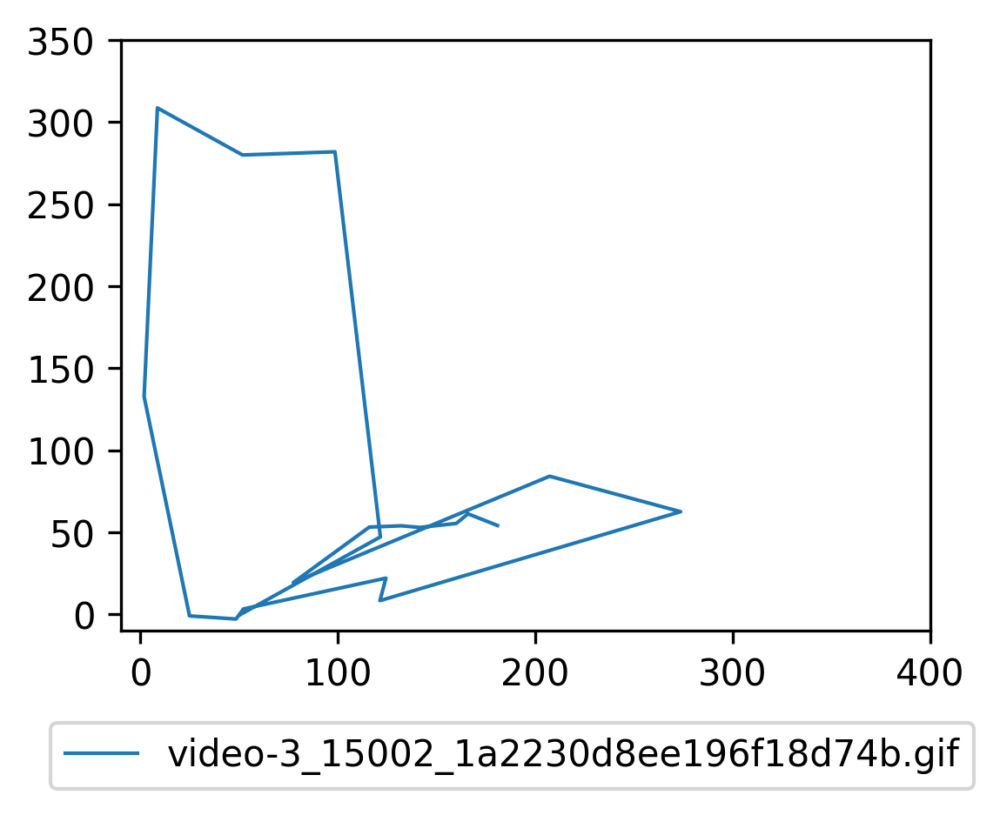

-------------------------------


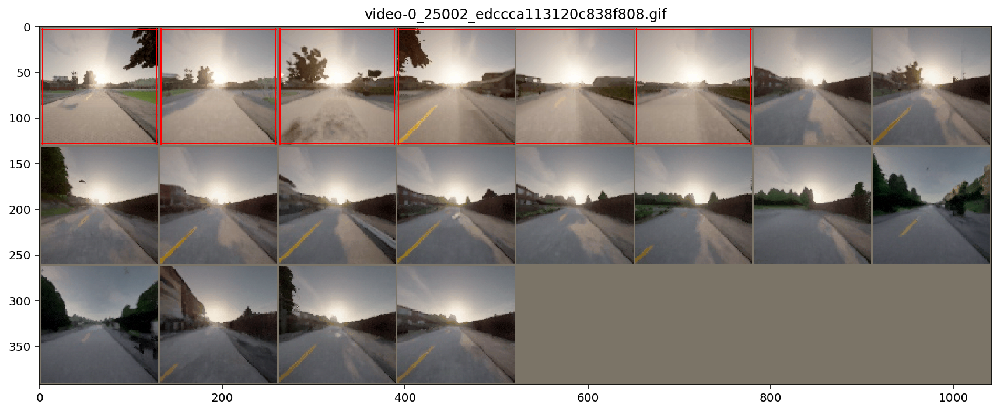

[[180.81491     54.191612  ]
 [165.87138     61.322533  ]
 [159.9516      55.437805  ]
 [141.41516     53.021202  ]
 [132.10844     54.012894  ]
 [115.90495     53.233994  ]
 [ 56.456764    -0.84768677]
 [178.18402     72.94501   ]
 [249.72823     15.078186  ]
 [ 77.96578      4.204071  ]
 [ 62.283577    30.582336  ]
 [ 43.200104     8.078461  ]
 [ 37.32376     -1.8147888 ]
 [ 24.167892    -1.4244995 ]
 [ 14.280197    -0.4744568 ]
 [ 18.383865   286.74805   ]
 [ 96.81589    259.8431    ]
 [ 94.229675   253.75072   ]
 [ 96.761925    11.948151  ]
 [ 44.780426    -0.32881165]]


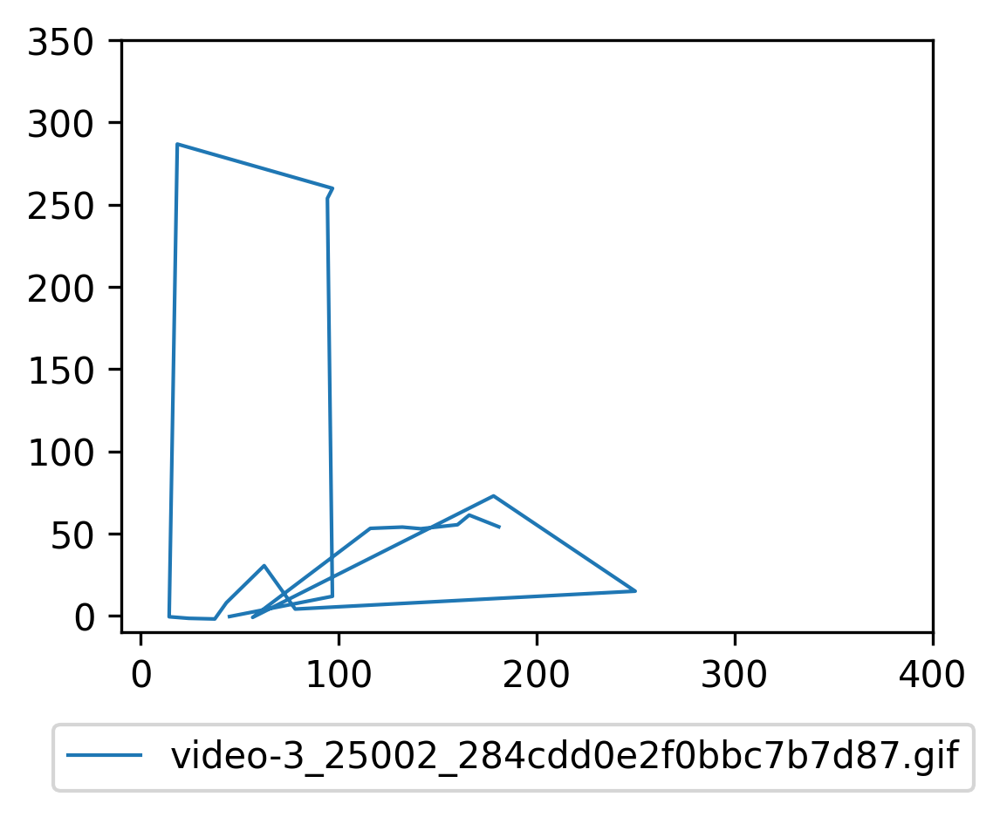

-------------------------------


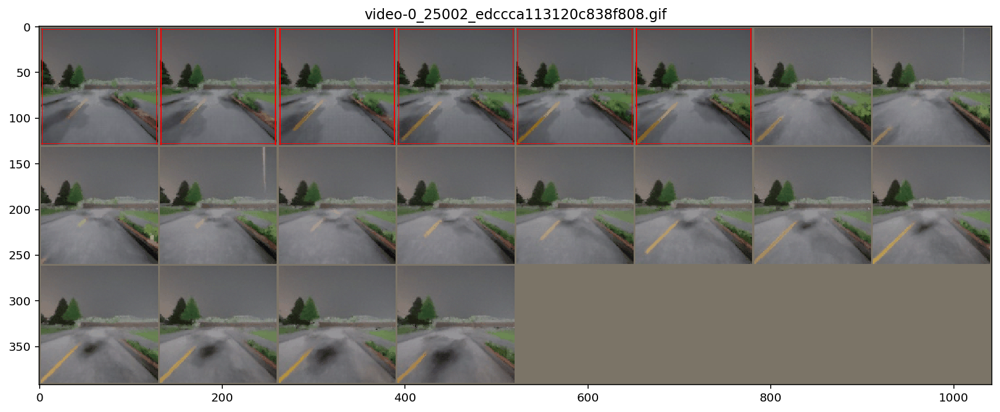

[[ 9.7666168e+00  2.2565292e+01]
 [ 9.7499695e+00  2.1537933e+01]
 [ 7.4454193e+00  2.2221764e+01]
 [ 9.4133453e+00  2.0336571e+01]
 [ 9.4161377e+00  2.0266479e+01]
 [ 8.0463409e+00  1.9477394e+01]
 [-1.4831543e-02  2.1271835e+01]
 [ 1.8672943e+00  2.0658096e+01]
 [ 1.6102753e+00  2.2603897e+01]
 [ 1.6746979e+00  2.2424332e+01]
 [ 1.6519165e+00  2.2945923e+01]
 [ 3.4361420e+00  2.3268028e+01]
 [ 1.7620239e+00  2.4416122e+01]
 [ 3.3561859e+00  2.3902161e+01]
 [ 3.0383759e+00  2.1554581e+01]
 [ 4.5656433e+00  2.0985008e+01]
 [ 2.1064911e+00  1.9563751e+01]
 [ 8.5421753e-01  1.9522652e+01]
 [ 3.2926178e+00  2.0831299e+01]
 [ 2.9936981e+00  2.1556114e+01]]


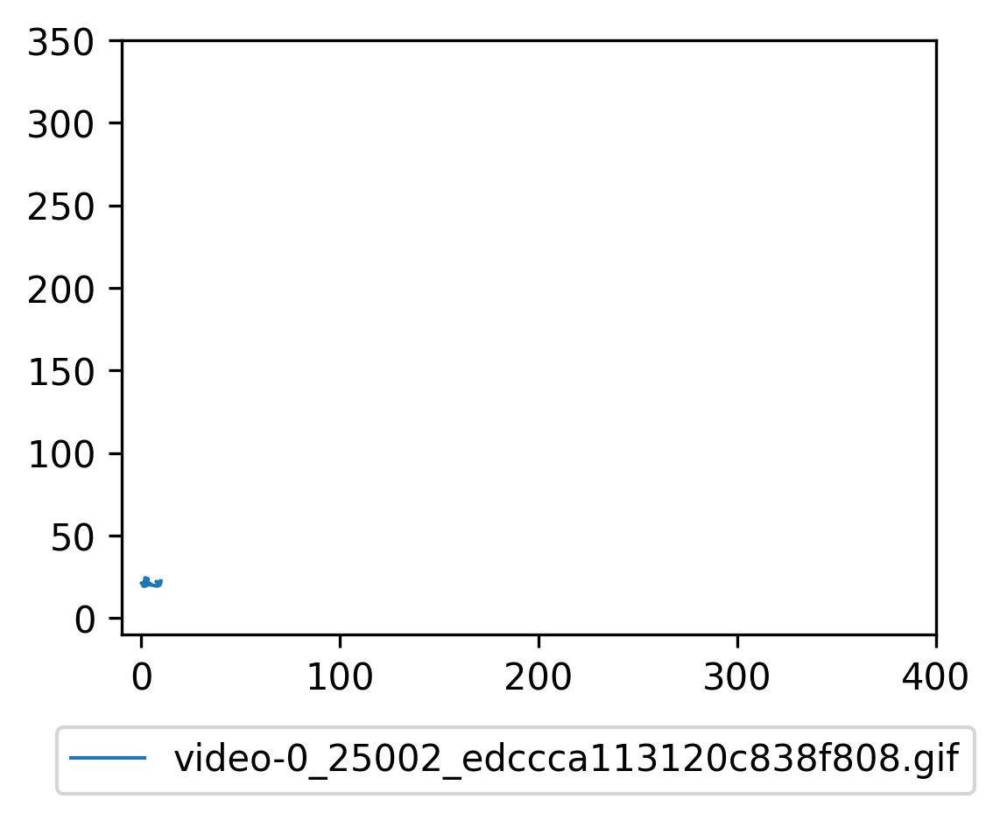

-------------------------------


In [190]:
for gif in gifs:
    inputs = next(iter(dataloaders[gif]))
    out = torchvision.utils.make_grid(inputs)
    imshow(out, k)
    out = predict_trajectory(dataloaders[gif])
    print(out)
    plot_trajectory(out, gif)
    print('-------------------------------')